In [1]:
%%capture
!pip install pydna
!pip install pandas
!pip install --upgrade xlrd
!pip install constrain

In [3]:
import IPython.core.display
import itertools
import numpy as np
import pandas as pd
import pydna
import pydna.primer
import pydna.dseqrecord
import pydna.amplify
import pydna.assembly
import pydna.gel
import pydna.ladders
from Bio import SeqIO
from pydna.dseqrecord import Dseqrecord
from Bio.SeqRecord import SeqRecord
from Bio.Seq import Seq

# 05_1_BUILD_CombinatorialLibrary_AllStrains

<a target="_blank" href="https://colab.research.google.com/github/hiyama341/ConStrain/blob/main/colab_notebooks/05_1_BUILD_CombinatorialLibrary_AllStrains.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

## Functions

In [2]:
# Functions
def primer_matrix_teselagen(teselagen_primer_matrix,teselagen_parts_matrix, combinations_matrix, no_combs:int, no_frags:int): 
    """Makes an primer matrix from teselagen output.

    Parameters
    ----------
    teselagen_primer_matrix : pandas DataFrame
        DataFrame with teselagen primer information, including the columns 'Name', 'Sequence', and 'Location'.
    teselagen_parts_matrix : pandas DataFrame
        DataFrame with teselagen part information, including the columns 'Sequence' and 'Overlaps_to'.
    combinations_matrix : list of list of Dseqrecord
        List of lists of Dseqrecord objects representing the combinations of parts.
    no_combs : int
        Number of combinations.

    Returns
    -------
    amplicon_matrix : list of list of tuple
        List of lists of tuples containing primer pairs for each combination.
    """
    #Initialize matrix
    primer_matrix = [[] for i in range(no_combs)]
    for comb_no in range(0, no_combs):
        for frag_no in range(0, no_frags):
            comb_seq = str(combinations_matrix[comb_no][frag_no].seq.upper())

            #G8H
            if frag_no == 1:
                #index used for getting the names from overlapping parts
                idx = frag_no + 1
            # CPR
            elif frag_no == 4:
                idx = frag_no - 1
            else:
                idx  = frag_no
#
            if idx != frag_no:
                name = combinations_matrix[comb_no][idx].name
                true_false = np.logical_and(teselagen_parts_matrix['Sequence'].str.contains(comb_seq), teselagen_parts_matrix['Overlaps_to'] == name)
            else:
                true_false = teselagen_parts_matrix['Sequence'].str.contains(comb_seq)

            
            comb_seq_idx = teselagen_parts_matrix[true_false].index

            forward_primer_name = teselagen_parts_matrix.loc[comb_seq_idx,['Forward Oligo Name']].values[0][0]
            reverse_primer_name = teselagen_parts_matrix.loc[comb_seq_idx,['Reverse Oligo Name']].values[0][0]

            forward_primer_idx  = teselagen_primer_matrix[teselagen_primer_matrix['Name'] == forward_primer_name].index
            forward_seq         = teselagen_primer_matrix.loc[forward_primer_idx,['Sequence']].values[0][0]
            forward_loc         = teselagen_primer_matrix.loc[forward_primer_idx,['Location']].values[0][0]
            forward_primer      = pydna.primer.Primer(pydna.dseqrecord.Dseqrecord(forward_seq, id = forward_primer_name))

            forward_primer.annotations['batches'] = []
            forward_primer.annotations['batches'].append({'location'      : forward_loc,
                                                          'volume'        : 100,
                                                          'concentration' : 10})
            reverse_primer_idx  = teselagen_primer_matrix[teselagen_primer_matrix['Name'] == reverse_primer_name].index
            reverse_seq         = teselagen_primer_matrix.loc[reverse_primer_idx,['Sequence']].values[0][0]
            reverse_loc         = teselagen_primer_matrix.loc[reverse_primer_idx,['Location']].values[0][0]
            reverse_primer      = pydna.primer.Primer(pydna.dseqrecord.Dseqrecord(reverse_seq, id = reverse_primer_name))
            reverse_primer.annotations['batches'] = []
            reverse_primer.annotations['batches'].append({'location'      : reverse_loc,
                                                          'volume'        : 100,
                                                          'concentration' : 10})

            primer_matrix[comb_no].append((forward_primer, reverse_primer))
            
    return primer_matrix


def amplicon_matrix_teselagen(teselagen_parts_matrix, primer_matrix,combinations_matrix, no_combs:int, no_frags:int):
    '''Makes an amplicon_matrix from tesselagen output. 
    
    Parameters
    ----------
    
    teselagen_parts_matrix : pd.DataFrame
    primer_matrix : list of list
    combinations_matrix : list of list 
    no_combs : int
        
    Returns
    -------
    amplicon_matrix : list of list'''
        
    #Initizalise
    amplicon_matrix = [[] for i in range(no_combs)]

    for comb_no in range(0, no_combs):
        for frag_no in range(0, no_frags):
            template       = pydna.dseqrecord.Dseqrecord(combinations_matrix[comb_no][frag_no])

            forward_primer = primer_matrix[comb_no][frag_no][0]
            reverse_primer = primer_matrix[comb_no][frag_no][1]

            amplicon = pydna.amplify.pcr(forward_primer, reverse_primer,  template)

            amplicon.annotations['template_name'] = template.name

            comb_seq = amplicon.seq.watson.upper()
            true_false = teselagen_parts_matrix['Sequence'].str.contains(comb_seq)
            comb_seq_idx = teselagen_parts_matrix[true_false].index

            amplicon_name  = teselagen_parts_matrix.loc[comb_seq_idx,['Name']].values[0][0]
            amplicon.name = amplicon_name

            amplicon_loc  = teselagen_parts_matrix.loc[comb_seq_idx,['Location']].values[0][0]
            amplicon_vol  = teselagen_parts_matrix.loc[comb_seq_idx,['volume']].values[0][0]
            amplicon_con  = teselagen_parts_matrix.loc[comb_seq_idx,['concentration']].values[0][0]
            amplicon.annotations['batches'] = []
            amplicon.annotations['batches'].append(  {'location'      : amplicon_loc,
                                                      'volume'        : amplicon_vol,
                                                      'concentration' : amplicon_con})

            amplicon.forward_primer.annotations['tm Q5 Hot Start'] = teselagen_parts_matrix.loc[comb_seq_idx,['Q5_fw_tm']].values[0][0]
            amplicon.reverse_primer.annotations['tm Q5 Hot Start'] = teselagen_parts_matrix.loc[comb_seq_idx,['Q5_rv_tm']].values[0][0]
            amplicon.annotations['ta Q5 Hot Start'] = teselagen_parts_matrix.loc[comb_seq_idx,['Q5_ta']].values[0][0]

            ## Remove additional wrong primer annotation added by pydna.amplify.pcr
            amplicon.features = [feat for feat in amplicon.features if feat.type != "primer_bind"]

            seq_to_annotation(amplicon, amplicon, "PCR_product")
            seq_to_annotation(forward_primer, amplicon, "primer_bind")
            seq_to_annotation(reverse_primer, amplicon, "primer_bind")

            amplicon_matrix[comb_no].append(amplicon)
            
    return amplicon_matrix



def set_plate_locations(amplicons:list): 
    '''Makes a dataframe from amplicons
    
    Parameters
    ----------
    
    amplicons : list 
        list of pydna.amplicon objects
        
    Returns
    -------
    pd.DataFrame 
        with overview of plate locations'''
    
    plate_locations = []
    for amplicon in amplicons:
        plate_locations.append([amplicon.name, 
                                amplicon.annotations['batches'][0]['location'],
                                amplicon.annotations['template_name'],
                                amplicon.template.annotations['batches'][0]['location'],
                                amplicon.forward_primer.id,
                                amplicon.forward_primer.annotations['batches'][0]['location'],
                                amplicon.reverse_primer.id,
                                amplicon.reverse_primer.annotations['batches'][0]['location']
                               ])
    amplicon_df = pd.DataFrame(plate_locations, columns=['name', 'location','template_name', 'template_location','fw_name','fw_location','rv_name','rv_location'])
    amplicon_df = amplicon_df.set_index('name')
    
    return amplicon_df



# Maybe redundant
def row_amplicons(row, amplicon_df, amplicons):
    """Returns a list of amplicons in a given gel row.

    Parameters
    ----------
    row : str
        Name of the gel row.
    amplicon_df : pandas DataFrame
        DataFrame with amplicon information, including the column 'prow' indicating the gel row.
    amplicons : list of Amplicon
        List of Amplicon objects.

    Returns
    -------
    list of Amplicon
        List of Amplicon objects in the given gel row.
    """
    row_names = amplicon_df[amplicon_df['prow']==row][['name']]['name'].tolist()

    row_amplicons = []
    for name in row_names:
        for amplicon in amplicons:
            if amplicon.name == name:
                row_amplicons.append([amplicon])

    return(row_amplicons)



def col_amplicons(col, amplicon_df, amplicons):
    """
    Returns a list of amplicons in a given gel column.

    Parameters
    ----------
    col : str
        Name of the gel column.
    amplicon_df : pandas DataFrame
        DataFrame with amplicon information, including the column 'pcol' indicating the gel column.
    amplicons : list of Amplicon
        List of Amplicon objects.

    Returns
    -------
    list of Amplicon
        List of Amplicon objects in the given gel column.
    """
    col_names = amplicon_df[amplicon_df['pcol']==col][['name']]['name'].tolist()
    
    col_amplicons = []
    for name in col_names:
        for amplicon in amplicons:
            if amplicon.name == name:
                col_amplicons.append([amplicon])
                
    return(col_amplicons)


def transformation_partitipants(reaction_participants, amnt =0.0005 , sgRNA_plasmid_name= None, sgRNA_plasmid_conc= None):
    """Returns a dict with the µl amounts needed in a transformation reaction.

    Parameters
    ----------
    reaction_participants : list of list of Dseqrecord
        List of lists of Dseqrecord objects representing the reaction participants.
    amnt : float, optional
        Amount in µl of the reagents other than `sgRNA_plasmid_name`. Default is 0.0005.
    sgRNA_plasmid_name : str, optional
        Name of the sgRNA plasmid. If not provided, `amnt` is used for all reaction participants.
    sgRNA_plasmid_conc : float, optional
        Concentration in µl of the sgRNA plasmid. If not provided, `amnt` is used for all reaction participants.

    Returns
    -------
    dict
        Dict with the µl amounts needed for the transformation reaction, 
        with keys being the names of the reaction participants and values being the corresponding µl amounts.
    """
    ...
    # Initialize two lists 
    wanted_amounts = [[] for i in range(len(reaction_participants))]
    names_matrix = [[] for i in range(len(reaction_participants))]
    for reac_no, reac in enumerate(reaction_participants):
        for parti_no, parti in enumerate(reac):
            if sgRNA_plasmid_name == None and sgRNA_plasmid_conc == None: 
                wanted_amounts[reac_no].append(amnt)
                names_matrix[reac_no].append(parti.name)
            else:
                names_matrix[reac_no].append(parti.name)
                if parti.name == sgRNA_plasmid_name:
                    wanted_amounts[reac_no].append(sgRNA_plasmid_conc)
                    names_matrix[reac_no].append(parti.name)
                else: 
                    wanted_amounts[reac_no].append(amnt)


    # making the reaction participants into Dseqrecords and changing names        
    new_dict_with_wanted_amounts = dict()
    for i in range(len(reaction_participants)):
        for j in range(len(reaction_participants[i])): 
            reaction_participants[i][j] = Dseqrecord(reaction_participants[i][j])
            new_dict_with_wanted_amounts[reaction_participants[i][j].name] = wanted_amounts[i][j]
    
    
    return new_dict_with_wanted_amounts 


def pool_parts(amplicons:list, part_names:list,part_amounts:list,  pool_names:list, pool_lengths)->dict: 
    """Pools amplicon parts and returns a dictionary of pooled volumes.

    Parameters
    ----------
    amplicons : list
        List of amplicon objects.
    part_names : list
        List of part names.
    part_amounts : list
        List of amounts of each part.
    pool_names : list
        List of pool names.
    pool_lengths : list
        List of pool lengths.

    Returns
    -------
    pooled_volumes : dict
        Dictionary containing the pooled volumes for each amplicon part.
    """
    # intialize
    pooled_volumes = {}
    
    #Iterate through the parts that are avilable
    for amplicon in amplicons:
        if amplicon.template.name in part_names:
            
            # calculate volume needed 
            ind1 = part_names.index(amplicon.template.name)
            amount = part_amounts[ind1]
            
            ind2 = pool_names.index(amplicon.template.name)
            vol = (pool_lengths[ind2]*650*amount)/amplicon.annotations['batches'][0]['concentration']
            
            # add it to the dictionary
            if amplicon.template.name in pooled_volumes:
                pooled_volumes[amplicon.template.name][amplicon.name] = {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}
            else:
                pooled_volumes[amplicon.template.name] = {amplicon.name: {'volume_to_mix':round(vol,1),'location':amplicon.annotations['batches'][0]['location'], 'concentration':amplicon.annotations['batches'][0]['concentration']}}

    return pooled_volumes


def print_pooled_parts(pooled_volumes: dict) -> None:
    """
    print_pooled_parts(pooled_volumes)
    Prints the pooled parts and calculated concentrations.

    Parameters
    ----------
    pooled_volumes : dict
        Dictionary containing the pooled volumes for each amplicon part.

    Returns
    -------
    None
    """
    print("To be pooled together")
    con_per_part = {}
    for key in pooled_volumes:
        print(key)
        total_vol = 0
        total_con = 0
        total_ng = 0
        for ke in pooled_volumes[key]:
            print(ke, pooled_volumes[key][ke])
            total_vol += pooled_volumes[key][ke]['volume_to_mix']
            total_con += pooled_volumes[key][ke]['concentration']
            total_ng += pooled_volumes[key][ke]['concentration'] * pooled_volumes[key][ke]['volume_to_mix']
        print("vol", round(total_vol, 1))
        print("calculated con", total_ng / total_vol, '\n')
        con_per_part[key] = round(total_ng / total_vol)
        total_con = 0
        total_vol = 0
        total_ng = 0

def calculate_volume_and_total_concentration(promoters, promoter_parts_amounts_total, n= 1):
    """
    Calculates the volume and total concentration of a list of promoters.
    
    Parameters
    ----------
    promoters : list
        A list of amplicon objects
    promoter_parts_amounts_total : dict
        A dictionary of amplicon names and their respective total amounts
    n : int (optional)
        Gives the option of multiplying the volume is needed. Optional set to 1. 
    
    Returns
    -------
    volumes : list
        List of volumes of each amplicon
    ngs : list
        List of ngs of each amplicon
    total_conc : float
        Total concentration of all amplicons
    """
    print('name, volume, concentration, location')

    volumes = []
    ngs = []
    for amp in promoters:
        w_moles = promoter_parts_amounts_total[amp.name]
        w_mass = wanted_mass(wanted_moles=w_moles, size=len(amp))
        act_conc = amp.annotations['batches'][0]['concentration']
        w_volume = wanted_volume(w_mass, act_conc)*n
        volumes.append(w_volume)
        ngs.append(w_volume * act_conc)
        print(amp.name, w_volume, act_conc, '\t', amp.annotations['batches'][0]['location'])

    #Count total concentrtaion expected   
    total_vol = sum(volumes)
    total_ngs = sum(ngs)
    total_conc = total_ngs/total_vol
    print('total volume: ', sum(volumes))
    print()
    print('total ngs: ', sum(ngs))
    print('total conc: ', total_conc)
    
    
def update_amplicon_annotations(amplicon_names:list, locations:list, concentrations:list,volumes:list )->None: 
    """Updates the annotations of amplicons in the amplicon list.
    
    Parameters
    ----------
    amplicon_names : list
        List of amplicon names.
    locations : list
        List of locations for each amplicon.
    concentrations : list
        List of concentrations for each amplicon.
    volumes : list
        List of volumes for each amplicon.

    Returns
    -------
    None
    """
    for i in range(len(amplicon_names)): 
        amplicon_by_name(amplicon_names[i], amplicons).annotations['batches'][0]['location'] = locations[i]
        amplicon_by_name(amplicon_names[i], amplicons).annotations['batches'][0]['concentration'] =concentrations[i]
        amplicon_by_name(amplicon_names[i], amplicons).annotations['batches'][0]['volume'] = volumes[i]
        
        

We can import the data repositoru like this: 

In [4]:
!git clone https://github.com/hiyama341/ConStrain_on_google_colab.git

fatal: destination path 'ConStrain_on_google_colab' already exists and is not an empty directory.


## 0. Intro


In this notebook, we aim to generate a combinatorial library of gene combinations and stochastically sample it to identify the highest producing combination of genes. A combinatorial library is a collection of all possible combinations of multiple genes or parts. 
Once the library is generated, we will stochastically sample it to identify the highest producing combination of genes. This approach allows us to explore a large number of possible combinations in a relatively short period of time, and it is a powerful tool for identifying the best performing combination of genes. 

To do so, we use the previously generated MIA-HA-1 (that does not contain G8H or CPR) as the background strain [04_1_BUILD_Background_strain.ipynb](../colab_notebooks/04_1_BUILD_Background_strain.ipynb). 
Addionally we use series of PCR amplified promoters, G8H and CPR homologs as repair templates for in vivo assembly with a CRISPR plasmid integrating these elements into the well-characterized XI-2 loci. 

### Project overview - Making the combinatorial library through one-pot assembly. 

**Hypothesis**
1. Specific combinations of CPR / G8H homologs and corresponding expression levels can remove the G8H bottleneck in the Strictosidine pathway

Aim: To test the hypothesis

Tasks
1. dgRNA
2. Base strain
**3. Library**
   - One-pot assembly of library constituents into the background strain MIA-HA-1
4. Phenotyping
5. Machine Learning


Below the genetic construct can be seen.

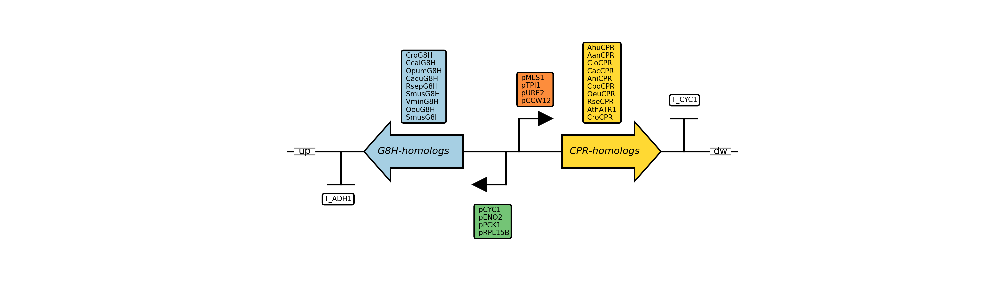

In [5]:
IPython.core.display.Image('ConStrain_on_google_colab/pictures/Genetic construct w dnaplotlib.png', width=2000)

Note on sequence homology: 
- As G8H and CPR parts have homology this library cannot be made in one transformation. Instead should be made in 8*10 individual transformation so as not to add two G8H or CPR homologs in one transformation mixtures.


## 1. Getting the sequences, volumes, concentrations from 

### 1.1 Templates names

In [6]:
G8H_template_names = ['CcalG8H_tADH1',
                     'CroG8H_tADH1',
                     'OpumG8H_tADH1',
                     'CacuG8H_tADH1',
                     'RsepG8H_tADH1',
                     'SmusG8H_tADH1',
                     'VminG8H_tADH1',
                     'OeuG8H_tADH1']
pG8H_template_names = ['pCYC1','pENO2','pPCK1','pRPL15B']

CPR_template_names = ["CroCPR_tCYC1",
                      "AanCPR_tCYC1",
                      "AthATR1_tCYC1",
                      "CloCPR_tCYC1",
                      "RseCPR_tCYC1",
                      "AhuCPR_tCYC1",
                      "AniCPR_tCYC1",
                      "CacCPR_tCYC1",
                      "OeuCPR_tCYC1",
                      "CpoCPR_tCYC1"]
pCPR_template_names = ['pCCW12','pMLS1','pTPI1','pURE2']

In [7]:
from constrain.lims.csv_database import get_dna_from_box_name

#### Importing the parts for the combinatorial library

In [8]:
path = 'ConStrain_on_google_colab/data/06-lims/csv_database/'
genbank_path = 'ConStrain_on_google_colab/data/06-lims/genbank_files/'

# Up and DW and Marker
UP_sites = [get_dna_from_box_name('UP_XI-2', 'ds_dna_box', database_path = path)]
DW_sites = [get_dna_from_box_name('DW_XI-2', 'ds_dna_box', database_path = path)]
marker_sites = [get_dna_from_box_name('seq_3HMRtcpy', 'ds_dna_box', database_path = path)]

# We can loop through the database to find our sequences - these sequence we need to 
G8H_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path, genbank = True, genbank_files_path =genbank_path ) for name in G8H_template_names]  
CPR_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path, genbank = True, genbank_files_path =genbank_path) for name in CPR_template_names]  

# Getting the promoters
pG8H_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path,genbank = True, genbank_files_path = genbank_path) for name in pG8H_template_names]  
pCPR_sites =[get_dna_from_box_name(name, 'ds_dna_box', database_path = path, genbank = True, genbank_files_path = genbank_path) for name in pCPR_template_names]  


We can make lists with the annotations we would like to fetch from the genbank files. That way we get only the specific sequence we are looking for. 

In [9]:
# G8H Promoters
pG8H_annotations = ['pCYC1','pENO2','pPCK1','pRPL15B']
pG8H_names = ['pCYC1','pENO2','pPCK1','pRPL15B']

# CPR Promoters
pCPR_annotations = ['pCCW12','pMLS1','pTPI1', 'pURE2']
pCPR_names = ['pCCW12','pMLS1','pTPI1', 'pURE2']

marker_cassette_annotations = ["TRP1_marker"]
marker_cassette_names = ["cTRP1"]

Note on sequence homology: 
- As G8H and CPR parts have homology this library cannot be made in one transformation. Instead should be made in 8*10 individual transformation so as not to add two G8H or CPR homologs in one transformation mixtures.



In [10]:
# renaming up and dw sites
UP_sites[0].name = 'XI-2_UP'
DW_sites[0].name = 'XI-2_DW'

#### Extract sites 

In [11]:
# Lets import some ConStrain function to help with the construction of the combinatorial library
from constrain.design.cloning import extract_template_amplification_sites, extract_sites, multiply_list, remove_tuple_duplicates, recs_no_duplicates, seq_to_annotation,plate_plot , casembler

In [12]:
pG8H_sites = extract_sites(pG8H_annotations, pG8H_sites, pG8H_names)
pCPR_sites = extract_sites(pCPR_annotations, pCPR_sites, pCPR_names)

We need to reverse complement the promoters for G8H because we are working with bi-directional promoters. 

In [13]:
pG8H_sites = [site.reverse_complement(annotations=True, name=True, id= True) for site in pG8H_sites]
pG8H_sites

[SeqRecord(seq=Seq('TATTAATTTAGTGTGTGTATTTGTGTTTGTGTGTCTATAGAAGTATAGTAATTT...CTG'), id='10033', name='pCYC1', description='<unknown description>', dbxrefs=[]),
 SeqRecord(seq=Seq('TATTATTGTATGTTATAGTATTAGTTGCTTGGTGTTATGAAAGAAACTAAGAAA...ATT'), id='10034', name='pENO2', description='<unknown description>', dbxrefs=[]),
 SeqRecord(seq=Seq('GTTGTTATTTTATTATGGAATAATTAGTTGCGTGAGTTTGGTTTTTTTTTTTAT...GTG'), id='10035', name='pPCK1', description='<unknown description>', dbxrefs=[]),
 SeqRecord(seq=Seq('TGCTTGTGTGGTAGGTAATTTGTGACTGTCTTTACGGTAGCTTTCGCCGATTAC...TAC'), id='10036', name='pRPL15B', description='<unknown description>', dbxrefs=[])]

#### Analyze the combinatorial space 

In [14]:
#Create a list of fragments within a list of parts.
fragment_list = [UP_sites,G8H_sites,pG8H_sites,pCPR_sites,CPR_sites,marker_sites,DW_sites]

#The number of fragments to be assembled
no_frags = len(fragment_list)
print("Number of fragments:", no_frags)

#The number of parts of each fragment
no_parts = [len(l) for l in fragment_list]
print("Number of parts: ",no_parts)

#The number of possible combinations
no_combs = multiply_list(no_parts)
print("Number of possible combinations:",no_combs)

#How many repitions are needed?
repetition_list = [int(no_comb/no_part) for no_comb, no_part in zip([no_combs]*len(no_parts),no_parts)]
print("The number of time each fragment must be repeated:", repetition_list)

#Matrix with all combinations
print("\nCombinations:")
combinations_matrix = [t for t in itertools.product(*fragment_list)]
for row in combinations_matrix:
    names = []
    for element in row:
        names.append(element.name)
    #print(names)
    #print(row)

Number of fragments: 7
Number of parts:  [1, 8, 4, 4, 10, 1, 1]
Number of possible combinations: 1280
The number of time each fragment must be repeated: [1280, 160, 320, 320, 128, 1280, 1280]

Combinations:


### 1.2 Overview of the library

The two following dataframes are primers and amplicons generated by tesselagens software. To use this information we need to take out the sequences, names and add them to python objects. We can do this in the following way: 

In [15]:
lea_primers = pd.read_excel("ConStrain_on_google_colab/data/04-genetic_parts/Teselagen/G8H_CPR_library.xls", sheet_name = "all primers").reset_index(drop=True)
lea_primers.head()

,Id,Name,Target Parts,Size,Cost,Tm,Tm (3' only),Sequence (3' only),Sequence,Location
0,3460,PR_UP_tADH1_05,XI-2_UP,22,2.2,58.178,58.178,GAGGATTTTCGATGGAGC,GAGGATTTTCGATGGAGC,o2_I06
1,3461,PR_UP_tADH1_06,XI-2_UP,64,6.4,69.335,57.264,TTGTGGAAGTTCATGGC,TAGGTCAGGTTGCTTTCTCAGGTATAGCATGAGGTCGCTCTTGTGG...,o2_I07
2,3407,PR_G8H_01,"VminG8H_tADH1,SmusG8H_tADH1,RsepG8H_tADH1,Cacu...",19,1.9,57.335,57.335,GAGCGACCTCATGCTATAC,GAGCGACCTCATGCTATAC,op4_A10
3,3408,PR_G8H_02,"VminG8H_tADH1,TIS_AAAACA",62,6.2,63.653,57.979,ATGGATTACTTGACGATCGC,AGACACACAAACACAAATACACACACTAAATTAATAAAAACAATGG...,op4_A01
4,3409,PR_G8H_03,"VminG8H_tADH1,TIS_AAAACA",61,6.1,64.693,57.979,ATGGATTACTTGACGATCGC,ACACCAAGCAACTAATACTATAACATACAATAATAAAAACAATGGA...,op4_B01


In [16]:
lea_parts = pd.read_excel("ConStrain_on_google_colab/data/04-genetic_parts/Teselagen/G8H_CPR_library.xls", sheet_name = "all parts").reset_index(drop=True)
lea_parts.head()

,Overlaps_to,order,Part,Promoter,Id,Name,Note,Forward Oligo Id,Forward Oligo Name,Reverse Oligo Id,...,Q5_ta,Length,Sequence,Location,Template_location,Template_name,Box_barcode,volume,concentration,Column1
0,pCYC1,1,NaN,NaN,2339,PCR_G8H_01,PCR,3407,PR_G8H_01,3408,...,63,1845,GAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACCTACAGGAA...,l5_A03,NaN,pMIA_087_Vmin_G8O_in_p0057_(TRP),81BOX762,100.0,40.0,NaN
1,pENO2,2,NaN,NaN,2340,PCR_G8H_02,PCR,3407,PR_G8H_01,3409,...,63,1844,GAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACCTACAGGAA...,l5_A04,NaN,pMIA_087_Vmin_G8O_in_p0057_(TRP),81BOX762,100.0,45.0,NaN
2,pPCK1,3,NaN,NaN,2341,PCR_G8H_03,PCR,3407,PR_G8H_01,3410,...,63,1841,GAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACCTACAGGAA...,l5_A05,NaN,pMIA_087_Vmin_G8O_in_p0057_(TRP),81BOX762,100.0,40.0,NaN
3,pRPL15B,4,NaN,NaN,2342,PCR_G8H_04,PCR,3407,PR_G8H_01,3411,...,63,1839,GAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACCTACAGGAA...,l5_A06,NaN,pMIA_087_Vmin_G8O_in_p0057_(TRP),81BOX762,100.0,45.0,NaN
4,pCYC1,5,NaN,NaN,2343,PCR_G8H_05,PCR,3407,PR_G8H_01,3412,...,63,1851,GAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACCTACAGGAA...,l5_A07,NaN,pMIA_090_Smus_G8O_in_p0057_(TRP),81BOX762,100.0,40.0,NaN


In [17]:
# initiate an empty list
primer_matrix = [[] for i in range(no_combs)]
len(primer_matrix)

1280

The outcome of this function is just a list of list with tuples that correspond to the primers for each fragment (for each strain)

In [18]:
primer_matrix = primer_matrix_teselagen(lea_primers,lea_parts, combinations_matrix, no_combs,no_frags)

In [19]:
primer_matrix[0]

[(PR_UP_tADH1_05 18-mer:5'-GAGGATTTTCGATGGAGC-3',
  PR_UP_tADH1_06 57-mer:5'-TAGGTCAGGTTGCTT..GGC-3'),
 (PR_G8H_01 19-mer:5'-GAGCGACCTCATGCTATAC-3',
  PR_G8H_34 67-mer:5'-AGACACACAAACACA..TGG-3'),
 (PR_PRO_01 35-mer:5'-TGTTTTTATTAATTT..TTG-3',
  PR_PRO_02 59-mer:5'-AGACAGGTCCATACG..GTG-3'),
 (PR_PRO_03 60-mer:5'-TTATCGAATGGGCAT..CCG-3',
  PR_PRO_04 34-mer:5'-TGTTTTATATTGATA..GAC-3'),
 (PR_CPR_30 54-mer:5'-CTGTCATTCGCTTAA..GAG-3',
  PR_CPR_02 20-mer:5'-TTCTCAAGCAAGGTTTTCAG-3'),
 (PR_TRP1-DW_01 61-mer:5'-CGCATGTAACATTAT..AGC-3',
  PR_TRP1-DW_02 18-mer:5'-CGTAGTGGGCCATCGCCC-3'),
 (PR_TRP1-DW_05 51-mer:5'-GCGAAAAACCGTCTA..GCT-3',
  PR_TRP1-DW_06 16-mer:5'-GTGGGAAGATTCCGCT-3')]

By reshaping it we can get all fragments 1 first then fragment 2  and so on. 

In [20]:
# By reshaping it we can get all fragments 1 first then fragment 2  and so on. 
primer_matrix_reshaped = [list(x) for x in zip(*primer_matrix)]

We can print to be sure

In [21]:
for frag_no, frag in enumerate(primer_matrix_reshaped):
    print("All primer pairs for fragment no: " + str(frag_no+1))


All primer pairs for fragment no: 1
All primer pairs for fragment no: 2
All primer pairs for fragment no: 3
All primer pairs for fragment no: 4
All primer pairs for fragment no: 5
All primer pairs for fragment no: 6
All primer pairs for fragment no: 7


Validate primer matrix by printing only different primers

In [22]:
primer_matrix_reshaped_no_duplicates = [remove_tuple_duplicates(lst) for lst in primer_matrix_reshaped]
len(primer_matrix_reshaped_no_duplicates)

7

In [23]:
for frag_no, frag in enumerate(primer_matrix_reshaped_no_duplicates):
    print("All primer pairs for fragment no: " + str(frag_no+1))

All primer pairs for fragment no: 1
All primer pairs for fragment no: 2
All primer pairs for fragment no: 3
All primer pairs for fragment no: 4
All primer pairs for fragment no: 5
All primer pairs for fragment no: 6
All primer pairs for fragment no: 7


Comments.
- All primer pairs for CPR contains 36 and not 40 pairs. This is because the four primers for RseCPR, CloCPR have the same sequence and the 4 and can be reused.
- Missing PR_CPR_05. Copy of PR_CPR_02 with additional t. Designed by mistake due to additional tCYC1 bp in template

In [24]:
lists_of_primers = []
# For each frag lst
for frag_no in range(0, no_frags):
    #From: list of tuples 
    #To  : list
    primers_tp = primer_matrix_reshaped_no_duplicates[frag_no]
    primers = [item for t in primers_tp for item in t]
    
    # From: list of primer
    # To: list of primers without sequence duplicates
    primers_no_dup = recs_no_duplicates(primers)
    
    lists_of_primers.append(primers_no_dup)

In [25]:
primers = [item for sublist in lists_of_primers for item in sublist]
print(f'Number of primers needed to generate the combinatorial library : {len(primers)}')

Number of primers needed to generate the combinatorial library : 92


### 1.3 Primers



Now that we got the sequences for the primers we can proceed with the following points: 


- add primers to storage in our CSV-database
- receive primers, dissolve to 10 μM, note volume
- add primers to storage physical

In [26]:
from constrain.lims.csv_database import get_database, get_box, add_sequences_to_dataframe, add_unique_ids

In [27]:
path = 'ConStrain_on_google_colab/data/06-lims/csv_database/'
primers_in_storage = get_database('primer_box', path= path)

In [28]:
# already did this 
#add_unique_ids(primers, path=path)
#add_sequences_to_dataframe(primers, primers_in_storage, 0)

In [29]:
box0 = get_box(0,primers_in_storage)
box0.head()

,ID,name,date,box,row,col,size,seq,concentration,volume,features,location,reference,comments,description
0,10041.0,PR_UP_tADH1_05_3460,08-15-2022,0,A,1,18.0,GAGGATTTTCGATGGAGC,NaN,NaN,[],primer_box_rack,NaN,Stock of primers for G8H-CPR library,Stock of primers for G8H-CPR library
1,10042.0,PR_UP_tADH1_06_3461,08-15-2022,0,A,2,57.0,TAGGTCAGGTTGCTTTCTCAGGTATAGCATGAGGTCGCTCTTGTGG...,NaN,NaN,[],primer_box_rack,NaN,Stock of primers for G8H-CPR library,Stock of primers for G8H-CPR library
2,10043.0,PR_G8H_01_3407,08-15-2022,0,A,3,19.0,GAGCGACCTCATGCTATAC,NaN,NaN,[],primer_box_rack,NaN,Stock of primers for G8H-CPR library,Stock of primers for G8H-CPR library
3,10044.0,PR_G8H_02_3408,08-15-2022,0,A,4,62.0,AGACACACAAACACAAATACACACACTAAATTAATAAAAACAATGG...,NaN,NaN,[],primer_box_rack,NaN,Stock of primers for G8H-CPR library,Stock of primers for G8H-CPR library
4,10045.0,PR_G8H_03_3409,08-15-2022,0,A,5,61.0,ACACCAAGCAACTAATACTATAACATACAATAATAAAAACAATGGA...,NaN,NaN,[],primer_box_rack,NaN,Stock of primers for G8H-CPR library,Stock of primers for G8H-CPR library


### 1.3 PCRs

Next we are interested in the 


- Simulate amplicons
- Add amplicons to to storage digitally
- Create pcrs, purify, estimate concentration and volume
- Add pcrs concentration and volume to storage digitally (Benchling batch information)
- Add pcrs to storage physical
- Retrieve pcrs concentration and volume from Benchling
- Restructure amplicons matrix to list of amplicons and amplicons

### 1.4 Simulate amplicons/PCRs

Next we are interested in the simulating the amplicons/PCRs with some functions in a HT way to make sure that the primers anneal to the template, figure out elongation times, melting temperatures and so on. 


The following function is alike the primer matrix function but the difference is that it will generate all the amplicons - from the templates with the primers and make a matrix with it. 


It checks that the primers anneal to the templates. Additinally it makes a new datatype, namely the pydna.amplicon which hold information about forward, reverse and template and much more.  

In [30]:
amplicon_matrix = amplicon_matrix_teselagen(lea_parts,primer_matrix,combinations_matrix, no_combs, no_frags)

In [31]:
amplicon_matrix[0]

[Amplicon(609),
 Amplicon(1845),
 Amplicon(1033),
 Amplicon(1023),
 Amplicon(2364),
 Amplicon(1451),
 Amplicon(599)]

In [32]:
amplicon_matrix_reshaped = [list(x) for x in zip(*amplicon_matrix)]

We reshape the matrix again and get rid of duplicates. Validate amplicon matrix by printing only different ampllicons

In [33]:
amplicon_matrix_reshaped_no_duplicates = [recs_no_duplicates(lst) for lst in amplicon_matrix_reshaped]

#### 1.4.1 Overview of all the parts that needs to be made for the combinatorial library. 

In [34]:
for frag_list_no, frag_list in enumerate(amplicon_matrix_reshaped_no_duplicates):
    print("All parts for fragment no: " + str(frag_list_no))
    for frag in frag_list:
        print(frag.name)
    print()

All parts for fragment no: 0
PCR_UP_tADH1_01

All parts for fragment no: 1
PCR_G8H_33
PCR_G8H_34
PCR_G8H_35
PCR_G8H_36
PCR_G8H_21
PCR_G8H_22
PCR_G8H_23
PCR_G8H_24
PCR_G8H_17
PCR_G8H_18
PCR_G8H_19
PCR_G8H_20
PCR_G8H_13
PCR_G8H_14
PCR_G8H_15
PCR_G8H_16
PCR_G8H_09
PCR_G8H_10
PCR_G8H_11
PCR_G8H_12
PCR_G8H_05
PCR_G8H_06
PCR_G8H_07
PCR_G8H_08
PCR_G8H_01
PCR_G8H_02
PCR_G8H_03
PCR_G8H_04
PCR_G8H_29
PCR_G8H_30
PCR_G8H_31
PCR_G8H_32

All parts for fragment no: 2
PCR_PRO_01
PCR_PRO_06
PCR_PRO_07
PCR_PRO_08

All parts for fragment no: 3
PCR_PRO_02
PCR_PRO_03
PCR_PRO_04
PCR_PRO_05

All parts for fragment no: 4
PCR_CPR_31
PCR_CPR_40
PCR_CPR_33
PCR_CPR_39
PCR_CPR_32
PCR_CPR_36
PCR_CPR_37
PCR_CPR_38
PCR_CPR_34
PCR_CPR_35
PCR_CPR_21
PCR_CPR_30
PCR_CPR_23
PCR_CPR_29
PCR_CPR_22
PCR_CPR_26
PCR_CPR_27
PCR_CPR_28
PCR_CPR_24
PCR_CPR_25
PCR_CPR_11
PCR_CPR_20
PCR_CPR_13
PCR_CPR_19
PCR_CPR_12
PCR_CPR_16
PCR_CPR_17
PCR_CPR_18
PCR_CPR_14
PCR_CPR_15
PCR_CPR_01
PCR_CPR_10
PCR_CPR_03
PCR_CPR_09
PCR_CPR_02
PCR_CPR_06

Print list of amplicons

In [35]:
amplicons = [item for sublist in amplicon_matrix_reshaped_no_duplicates for item in sublist]
print(f'All amplicons to generate the combinatorial library : {len(amplicons)}')

All amplicons to generate the combinatorial library : 83


The objects hold a lot of information as you can see below. For example, location, concentraion , volume and so on of the template.  

In [36]:
amplicons[0].template.annotations

{'box': 0,
 'row': 'A',
 'col': 1,
 'batches': [{'location': 'ds_dna_box_rack_0_A1',
   'volume': 200.0,
   'concentration': 50.0}],
 'molecule_type': 'DNA'}

Lets calculate how long elomgation time is for each amplicon with the designated polymerase:

In [37]:
from constrain.lab.PCR import calculate_processing_speed, calculate_elongation_time, pcr_locations, calculate_volumes

In [38]:
pol = 'Q5 Hot Start'
for amplicon in amplicons:
    amplicon.annotations['polymerase'] = pol
    amplicon = calculate_processing_speed(amplicon)
    amplicon = calculate_elongation_time(amplicon)
    
    # adding necessary annotations to add them to the csv database
    amplicon.annotations['reference'] = 'PCR_G8H_CPR'
    amplicon.annotations['comments'] = 'Parts for the G8H library'
    

We can see that we have added additional information to the amplicon. 

In [39]:
amplicons[4].annotations

{molecule_type: 'DNA',
 'template_name': 'CcalG8H_tADH1',
 'batches': [{'location': 'l5_E02', 'volume': 100.0, 'concentration': 35.0}],
 'ta Q5 Hot Start': 62,
 'polymerase': 'Q5 Hot Start',
 'proc_speed': 30,
 'elongation_time': 56,
 'reference': 'PCR_G8H_CPR',
 'comments': 'Parts for the G8H library'}

#### 1.4.2 Add amplicons to csv_database


Lets add all the amplicons to our PCR box to make it easy to fetch later on. 

In [40]:
from constrain.lims.csv_database import get_database, get_box, add_sequences_to_dataframe, add_unique_ids

In [41]:
path = 'ConStrain_on_google_colab/data/06-lims/csv_database/'
amplicons_in_storage = get_database('PCR_box', path= path)

In [42]:
# already did this 
#add_unique_ids(amplicons, path=path)
#add_sequences_to_dataframe(amplicons, amplicons_in_storage, 81)

In [43]:
box2 = get_box(1,amplicons_in_storage)
box2.head()

,ID,name,date,box,row,col,size,seq,concentration,volume,features,location,reference,comments,description
81,10162.0,PCR_UP_tADH1_01,09-22-2022,1,A,1,609.0,GAGGATTTTCGATGGAGCAGGATGAGGAGAAATAGTACCACATGTA...,30.0,100.0,"[SeqFeature(FeatureLocation(ExactPosition(0), ...",l5_I08,PCR_G8H_CPR,Parts for the G8H library,pcr_product_description_description
82,10163.0,PCR_G8H_33,09-22-2022,1,A,2,1845.0,GAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACCTACAGGAA...,50.0,100.0,"[SeqFeature(FeatureLocation(ExactPosition(0), ...",l5_D08,PCR_G8H_CPR,Parts for the G8H library,pcr_product_description_description
83,10164.0,PCR_G8H_34,09-22-2022,1,A,3,1844.0,GAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACCTACAGGAA...,50.0,100.0,"[SeqFeature(FeatureLocation(ExactPosition(0), ...",l5_D09,PCR_G8H_CPR,Parts for the G8H library,pcr_product_description_description
84,10165.0,PCR_G8H_35,09-22-2022,1,A,4,1841.0,GAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACCTACAGGAA...,35.0,100.0,"[SeqFeature(FeatureLocation(ExactPosition(0), ...",l5_E01,PCR_G8H_CPR,Parts for the G8H library,pcr_product_description_description
85,10166.0,PCR_G8H_36,09-22-2022,1,A,5,1839.0,GAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACCTACAGGAA...,35.0,100.0,"[SeqFeature(FeatureLocation(ExactPosition(0), ...",l5_E02,PCR_G8H_CPR,Parts for the G8H library,pcr_product_description_description


### 1.5 Create physical pcrs, purify, estimate concentration and volume

PCR
- Polymerase: Q5 2x MasterMix [protocol](https://international.neb.com/protocols/2012/08/30/protocol-for-q5-hot-start-high-fidelity-2x-master-mix-m0494)
- Program: Create according to protocol
- Elongation time: 1.5 min (30 s/ kb)
- Annealing temp 58
    - All primers are designed to have 3' Tm 59C-54C, and Ta 59C-62C when using  Q5 2x MasterMix (calculated with NEB Tm calculator)

In [44]:
longest_amplicon = 0
for parts in amplicon_matrix_reshaped_no_duplicates:
    for amp in parts:
        if len(amp) > longest_amplicon: longest_amplicon = len(amp)
print("Length of longest amplicon: \t" + str(longest_amplicon) + " bp")
print("Elongation time: \t\t"  + str(round(longest_amplicon/1000 * 35,1))+ " seconds")

Length of longest amplicon: 	2369 bp
Elongation time: 		82.9 seconds


annealing temp: double check. Lea writes 59. 57 maybe fine. most cases amplification from plasmid
annealing time: 10–30 seconds -> increase a bit from 10s
elongation time: 0:27 seconds -> increase to 1:30 seconds

We can check the PCR programs in the follwing way: 

In [45]:
amplicon_matrix[0][1].dbd_program() #.dbd_program

|98°C|98°C               |    |tmf:53.8
|____|_____          72°C|72°C|tmr:55.1
|30s |10s  \ 56.8°C _____|____|15s/kb
|    |      \______/ 0:27|5min|GC 40%
|    |       10s         |    |1845bp

In [46]:
for a in amplicon_matrix_reshaped_no_duplicates[1]:
    print(a.name, len(a))

PCR_G8H_33 1845
PCR_G8H_34 1844
PCR_G8H_35 1841
PCR_G8H_36 1839
PCR_G8H_21 1737
PCR_G8H_22 1736
PCR_G8H_23 1733
PCR_G8H_24 1731
PCR_G8H_17 1902
PCR_G8H_18 1901
PCR_G8H_19 1898
PCR_G8H_20 1896
PCR_G8H_13 1869
PCR_G8H_14 1868
PCR_G8H_15 1865
PCR_G8H_16 1863
PCR_G8H_09 1845
PCR_G8H_10 1844
PCR_G8H_11 1841
PCR_G8H_12 1839
PCR_G8H_05 1851
PCR_G8H_06 1850
PCR_G8H_07 1847
PCR_G8H_08 1845
PCR_G8H_01 1845
PCR_G8H_02 1844
PCR_G8H_03 1841
PCR_G8H_04 1839
PCR_G8H_29 1845
PCR_G8H_30 1844
PCR_G8H_31 1841
PCR_G8H_32 1839


#### Design PCR plate:

- Locations and amounts (each well ~20x 50 µl PCR reactions):
    - amplicons
    - templates          >= 20 µl, 10-20 ng/ul
    - fw_primers         >= 75 µl, 10 µM total
    - rv_primers         >= 75 µl, 10 µM total
    - fw_and_rv_primers  >= 100 µl, 10 µM total (5 µM each)

ampliconPools
1. Design
2. Upload (name, sequence, register)
3. construct
    - when constructed
        - purify (physically)
        - find box with available position (algorithmically)
        - create container and batch (algorithmically)
        - label and place (physically)
4. Download for simulation

Want enough parts:
Don't want to pool parts that have been purified individually.
Create more parts redo 2021-02-25 PCR
 - adding new primers template for D11 and E11
 - op4_:D10,11; E10,11
 - Template = MIA-HA-1 col # 3 
 - At pTPI1 58, pURE2 58 (should work although last time 61)
 
Pool homolog / promoter parts and purify and measure concentration, upload information to benchling

redo 2021-02-25 PCR
PCR
- Polymerase: Q5 2x MasterMix [protocol](https://international.neb.com/protocols/2012/08/30/protocol-for-q5-hot-start-high-fidelity-2x-master-mix-m0494)
- Program: Create according to protocol
- Elongation time: 1.5 min (30 s/ kb)
- Annealing temp 58

In [47]:
amplicon_df = set_plate_locations(amplicons)

In [48]:
map_name_plocation = pd.read_csv("ConStrain_on_google_colab/data/06-lims/mapping_pcr_to_name/mapping PCR name to plate location.csv").set_index('name') #mapping: PCR plate location to PCR name
amplicon_df = pd.concat([amplicon_df, map_name_plocation], axis=1, join="outer")
amplicon_df.index.names = ['name']
amplicon_df = amplicon_df.reset_index()
amplicon_df = amplicon_df.sort_values(by=['prow', 'pcol'])
amplicon_df

,name,location,template_name,template_location,fw_name,fw_location,rv_name,rv_location,prow,pcol
25,PCR_G8H_01,l5_A03,VminG8H_tADH1,ds_dna_box_rack_0_C3,PR_G8H_01,op4_A10,PR_G8H_02,op4_A01,A,1
21,PCR_G8H_05,l5_A07,SmusG8H_tADH1,ds_dna_box_rack_0_C2,PR_G8H_01,op4_A10,PR_G8H_06,op4_A02,A,2
17,PCR_G8H_09,l5_B02,RsepG8H_tADH1,ds_dna_box_rack_0_C1,PR_G8H_01,op4_A10,PR_G8H_10,op4_A03,A,3
13,PCR_G8H_13,l5_B06,CacuG8H_tADH1,ds_dna_box_rack_0_B9,PR_G8H_01,op4_A10,PR_G8H_14,op4_A04,A,4
9,PCR_G8H_17,l5_C01,OpumG8H_tADH1,ds_dna_box_rack_0_B8,PR_G8H_01,op4_A10,PR_G8H_18,op4_A05,A,5
...,...,...,...,...,...,...,...,...,...,...
48,PCR_CPR_38,l5_H07,CacCPR_tCYC1,ds_dna_box_rack_0_A7,PR_CPR_37,op4_H08,PR_CPR_02,op4_B10,H,8
49,PCR_CPR_34,l5_I02,OeuCPR_tCYC1,ds_dna_box_rack_0_B1,PR_CPR_33,op4_H09,PR_CPR_02,op4_B10,H,9
50,PCR_CPR_35,l5_I06,CpoCPR_tCYC1,ds_dna_box_rack_0_A9,PR_CPR_34,op4_H10,PR_CPR_02,op4_B10,H,10
36,PCR_PRO_08,l4_D05,pRPL15B,ds_dna_box_rack_0_C8,PR_PRO_15,op4_H11,PR_PRO_16,op4_H12,H,11


#### Display plate configurations

In [49]:
display_plate_configuration = False

In [50]:
if display_plate_configuration: 
    print('PCR name')
    display(plate_plot(amplicon_df, 'name'))

    # Template
    print('Template name')
    display(plate_plot(amplicon_df, 'template_name'))
    print('Template location')
    display(plate_plot(amplicon_df, 'template_location'))

    # Forward primer
    print('Forward primer name')
    display(plate_plot(amplicon_df, 'fw_name'))
    print('Forward primer location')
    display(plate_plot(amplicon_df, 'fw_location'))

    # Reverse primer
    print('Reverse primer name')
    display(plate_plot(amplicon_df, 'rv_name'))
    print('Reverse primer location')
    display(plate_plot(amplicon_df, 'rv_location'))
    
    print('Amplicons')
    display(pcr_locations(amplicons))

#### Calculate PCR volumes 

In [51]:
calculate_volumes(vol_p_reac = 50, 
        no_of_reactions = 100,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_100_reac
Template,1.0,100.0
Primer 1,2.5,250.0
Primer 2,2.5,250.0
H20,19.0,1900.0
Pol,25.0,2500.0
Total,50.0,5000.0


#### Simulate gels

In [52]:
simulate_gels = False

Row A + B 

In [53]:
if simulate_gels:
    row = row_amplicons("A", amplicon_df, amplicons)+row_amplicons("B", amplicon_df, amplicons)
    row_no = 1
    for amp in row:
        print("Row "+str(row_no)+": "+amp[0].name)
        row_no += 1
    pydna.gel.gel([pydna.ladders.PennStateLadder,*row])

Row C + D 

In [54]:
if simulate_gels:
    row = row_amplicons("C", amplicon_df, amplicons)+row_amplicons("D", amplicon_df, amplicons)
    row_no = 1
    for amp in row:
        print("Row "+str(row_no)+": "+amp[0].name)
        row_no += 1
    pydna.gel.gel([pydna.ladders.PennStateLadder,*row])

In Preview
- in 'adjust color' max exposure, max shadows
- annotated with filename, sample number to well correspondande and other helpfull annotations 

#### Results of amplicons A-D

In [55]:
bioimager_path = 'ConStrain_on_google_colab/data/05-gel_bioimager_nanophotometer/raw/bioimager/'

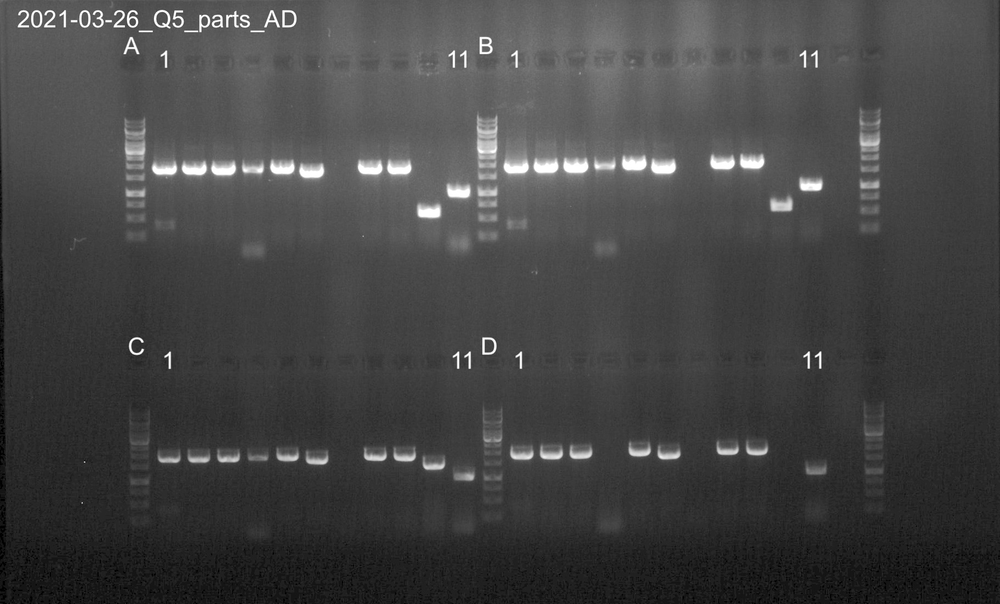

In [56]:
IPython.core.display.Image(bioimager_path+'/2021-03-26_Q5_parts_AD.jpg', width=600)

Row E + F 

In [57]:
if simulate_gels:
    row = row_amplicons("E", amplicon_df, amplicons)+row_amplicons("F", amplicon_df, amplicons)
    row_no = 1
    for amp in row:
        print("Row "+str(row_no)+": "+amp[0].name)
        row_no += 1
    pydna.gel.gel([pydna.ladders.PennStateLadder,*row])

Row G + H 

In [58]:
if simulate_gels:
    row = row_amplicons("G", amplicon_df, amplicons)+row_amplicons("H", amplicon_df, amplicons)
    row_no = 1
    for amp in row:
        print("Row "+str(row_no)+": "+amp[0].name)
        row_no += 1
    pydna.gel.gel([pydna.ladders.PennStateLadder,*row])

#### Results of amplicons E-H

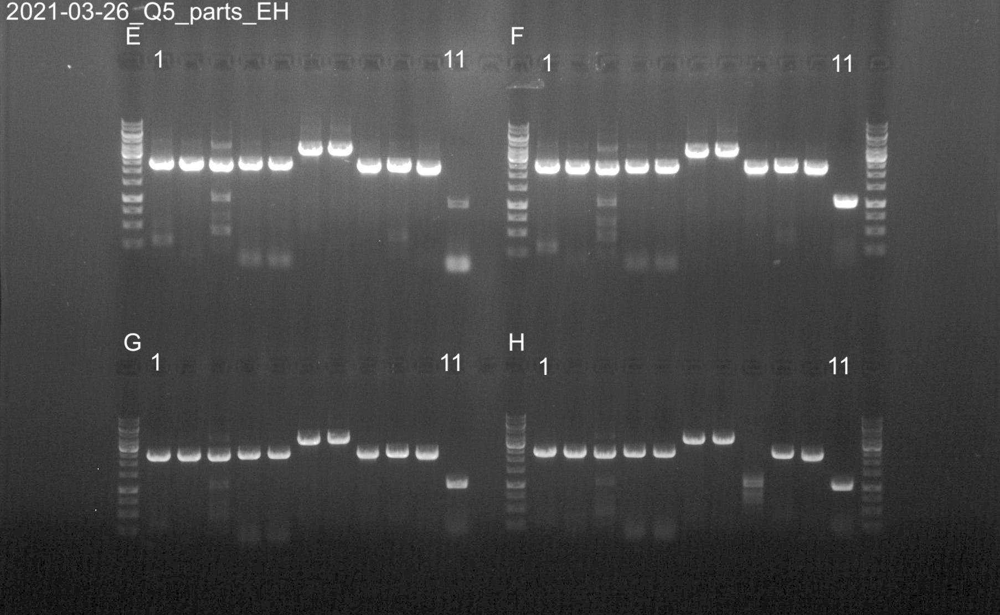

In [59]:
IPython.core.display.Image(bioimager_path+'2021-03-26_Q5_parts_EH.jpg', width=600)

**Results**

**Discussion**
- failed
    - D4
    - H8
    - AD7 (expected no template)

- unspecific bands 
    - AD1 (still most of correct band) 
    - EH3 (alot uncorrect band)

**Conclusion**
- redo EH3 AT 63 C

redo EH3 with AT 63C

In [60]:
calculate_volumes(vol_p_reac = 50, 
        no_of_reactions = 4,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_4_reac
Template,1.0,4.0
Primer 1,2.5,10.0
Primer 2,2.5,10.0
H20,19.0,76.0
Pol,25.0,100.0
Total,50.0,200.0


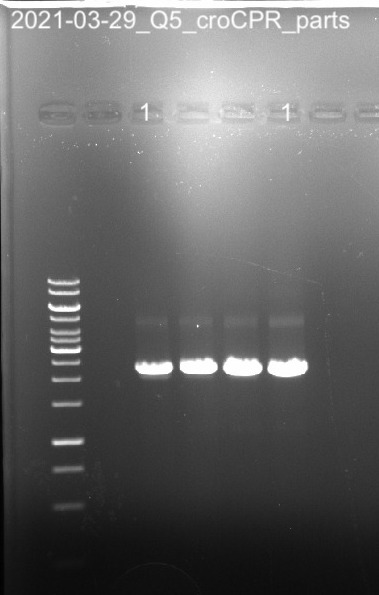

In [61]:
IPython.core.display.Image(bioimager_path+'2021-03-26_Q5_croCPR_parts.jpg', width=100)

**Results**

**Discussion**

**Conclusion**

column purify:
- pool:
    - homologs (4PCRs) 8+10 = 18
    - promoters (2x4PCRS; pool after purification) 2
- individually
    - AC10 (A10=UP, DW, cTRP) 3

1. Order homologs (G8H, CPR), promoters (1-4, 5-8), UP, DW, cTRP
2. Pool UP DW and cTRP with earlier batches to get enough.
3. Use a pool of batches of promoters earlier purified to get equimolar amounts.

## 2. Simulating the in-vivo assemblies

In this section we will generate the strains that we will make in the combinatorial library. As described before we will simulate all the assemblies and generate genbank files for all assembled strains. More specifically we can do this by using our casembler function that will simulate the double stranded break Cas9 does with the appropriate sgRNA and then simulate the in-vivo assembly. 

In [62]:
# Importing the strain that we are gonna use
HA1 = SeqIO.read('ConStrain_on_google_colab/data/03-strain_sequences/background_and_controls/MIA-HA-1.gb', format = 'genbank')
HA1.annotations["batches"] = [{'location':'freezer', 'volume':178, 'concentration':102}]

# Importing the gRNA we are gonna use
XI2_2_gRNA = pydna.dseqrecord.Dseqrecord("ACCCCCCTCAACTGATCAAC", name = "XI2-2_gRNA")

In [63]:
# We have to make the id into str for the casembler to work. 
for i in range(len(amplicon_matrix)):
    for j in range(len(amplicon_matrix[i])): 
        amplicon_matrix[i][j].template.id = str(amplicon_matrix[i][j].template.id)

In [64]:
# Making systematic names for the strains i.e '1_1_1_1','1_1_1_2'... etc.
list(range(1,8))

assembly_names = []
for g_no in range(1,9):
    for gp_no in range(1,5):
        for cp_no in range(1,5):
            for c_no in range(1,11):
                assembly_names.append(str(g_no) +"_"+ str(gp_no) +"_"+ str(cp_no) +"_"+ str(c_no))
                

print(f'Total number of combinations : {len(assembly_names)}')
print(f'This is the systematic name of the first assembled strain : {assembly_names[0]}')

Total number of combinations : 1280
This is the systematic name of the first assembled strain : 1_1_1_1


In [65]:
# add parameters
parameters = {'bg_strain': HA1,         # The background strain that have deleted G8H and CPR
              'site_names': ["XI-2"],   # THe integration site 
              'gRNAs': [XI2_2_gRNA],    # Name of the sgRNA
              #    'parts': [flat_cro_combinations_matrix[i]],
              'assembly_limits':[30],   # How many 
              'verbose': False,         # Make longer output
              'to_benchling': False     # If you want to send it to benchling  
              }

### 2.1 Casembler

This function can take some time(approx 10 min). It has to assemble 1280 strains DNA. Be patient please. 

In [66]:
#%%time
## assembling the strains
#assemblies = []
#for i, name in enumerate(assembly_names):
#    assembly = casembler(**{'parts'          : [amplicon_matrix[i]],
#                                  'assembly_names' : [name], 
#                                   **parameters})
#    assemblies.append(assembly)
#len(assemblies)

In [67]:
#assemblies = [Dseqrecord(contig) for contig in assemblies]

Already saved the assemblies as gb files 

In [68]:
##2. Save the assemblies as gb files 
#for contig in assemblies: 
#    with open(f"ConStrain_on_google_colab/data/03-strain_sequences/all_strains_assembled/{contig.name}.gb", 'w') as outfile:
#        print(contig.format("gb"), file = outfile)

### 2.2 Make a pooled library of parts 

Update the concetrations of the parts

In [69]:
df_nanophotometer_conc = pd.read_excel('ConStrain_on_google_colab/data/05-gel_bioimager_nanophotometer/raw/nanophotometer/2021-03-29_G8H_CPR_library_part_concentrations.xlsx')
df_nanophotometer_conc.columns = df_nanophotometer_conc.iloc[1]
df_nanophotometer_conc = df_nanophotometer_conc.iloc[:,[4]].values.tolist()

#unnest
pool_concentrations = []
for i in range(1,len(df_nanophotometer_conc)):
    pool_concentrations.append(df_nanophotometer_conc[i][0])

In [70]:
# remove sample AD7 -  3.8 ng /ul
#pool_concentrations.remove(3.8) later

# pool 2 promoter samples 88,77.6 into 82.8
concs = pool_concentrations[-5:-3]
concs_mean = sum(concs) / len(concs)
pool_concentrations = [conc for conc in pool_concentrations if conc not in concs]
pool_concentrations.insert(-3, concs_mean)

Add  sites batches to pool: 
- UP
    - PCR_UP_tADH1_01-002 - 005 into XI-2_UP-001
    - l4_E7 - F1 into H9 (23.7)
    
- DW
    - PCR_TRP1-DW_02-002 - 005 into XI-2_DW-001
    - l4_F2 - F6 into I1 (17.5)

- cTRP
    - PCR_TRP1-DW_01-001 - 004 into cTRP1-001
    - l4_E4 - E6 into I2 (39.9)

Archive expanded samples l4_E4-F6

In [71]:
from constrain.lab.PCR import amplicon_by_name
from constrain.utils import mean

In [72]:
# pool equimolar ratio
promoter_conc = [100,100,100,90,120,110,75,120]

# pool all, fragments are the same, same length
UP_concs = [40, 30, 30, 35, 23.7]
DW_concs = [60, 60, 40, 50, 17.5]
cTRP_concs = [160, 150, 140, 39.9]

In [73]:
pool_names = ['VminG8H_tADH1','SmusG8H_tADH1','RsepG8H_tADH1','CacuG8H_tADH1','OpumG8H_tADH1','CroG8H_tADH1','PcoG8H_tADH1','OeuG8H_tADH1','CcalG8H_tADH1','CroCPR_tCYC1','AanCPR_tCYC1','AraCPR_tCYC1','CloCPR_tCYC1','RseCPR_tCYC1','AhuCPR_tCYC1','AniCPR_tCYC1','CacCPR_tCYC1','OeuCPR_tCYC1','CpoCPR_tCYC1','Promoters','XI-2UP','XI-2DW','cTRP1']

pool_lengths = [1845,1851,1845,1869,1902,1737,1412,1845,1845,2365,2335,2300,2365,2365,2365,2305,2347,2347,2260,1033,609,599,1451]

# we just add many 'A's' to indicate that it is a pool of amplicons
pool_bases = ['A'* pool_length for pool_length in pool_lengths]

pool_positions = ['A1','A2','A3','A4','A5','A6','A7','A8','B1','B2','B3','B4','B5','B6','B7','B8','C1','C2','C3','C4','C5','C6','C7']


# Update due pooling with previously made batches
pool_bases[-3] = amplicon_by_name('PCR_UP_tADH1_01',amplicons).seq.watson # UP
pool_bases[-2] = amplicon_by_name('PCR_TRP1-DW_02',amplicons).seq.watson # DW
pool_bases[-1] = amplicon_by_name('PCR_TRP1-DW_01',amplicons).seq.watson # cTRP

pool_concentrations[-3] = mean(UP_concs)
pool_concentrations[-2] = mean(DW_concs)
pool_concentrations[-1] = mean(cTRP_concs)

pool_volumes = [100] * len(pool_names)
pool_volumes[-3] = 100 * len(UP_concs) # UP
pool_volumes[-2] = 100 * len(DW_concs) # DW
pool_volumes[-1] = 100 * len(cTRP_concs) # cTRP

In [74]:
cro_strain_batches = pd.DataFrame.from_dict({
'entity_name' : pool_names,
'Bases': pool_bases,
'Box_barcode' : ['81BOX827'] * len(pool_names),
'position' : pool_positions,
'volume' : pool_volumes,
    
'volume unit' : ['ul'] * len(pool_names),
'concentration' : pool_concentrations,
'concentration unit' : ['ng/ul'] * len(pool_names),
}
)
cro_strain_batches

,entity_name,Bases,Box_barcode,position,volume,volume unit,concentration,concentration unit
0,VminG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,A1,100,ul,142.800,ng/ul
1,SmusG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,A2,100,ul,134.500,ng/ul
2,RsepG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,A3,100,ul,137.000,ng/ul
3,CacuG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,A4,100,ul,40.100,ng/ul
4,OpumG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,A5,100,ul,134.000,ng/ul
5,CroG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,A6,100,ul,144.600,ng/ul
6,PcoG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,A7,100,ul,3.800,ng/ul
7,OeuG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,A8,100,ul,129.300,ng/ul
8,CcalG8H_tADH1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,B1,100,ul,132.300,ng/ul
9,CroCPR_tCYC1,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,B2,100,ul,141.500,ng/ul


#### Add the pool to the csv-database

In [75]:
from constrain.lims.csv_database import add_annotations, add_unique_ids, add_sequences_to_dataframe, update_database, get_box, get_database

In [76]:
## Updating the of the pooled batched and add it to the database 
pcr_box = get_database('PCR_box', path="ConStrain_on_google_colab/data/06-lims/csv_database/")

In [77]:
pooled_PCR_products =[]
# making all the pooled parts into biopython objects
for index, row in cro_strain_batches.iterrows():
    Record = SeqRecord(Seq(row['Bases']))
    Record.name = row['entity_name']
    Record.annotations['batches'] = [{'location':'PCR_box', 'volume': row['volume'], 'concentration':row['concentration']}]
    Record.description = 'These are pooled parts from the G8H_lib'
    Record.annotations['reference'] = 'They are a mix of their respective parts -check their name- with different overhangs'
    Record.annotations['comments'] = 'The multiple As indicate a mixture of parts'
    pooled_PCR_products.append(Record)
    
# giving them unique ids
add_unique_ids(pooled_PCR_products,  path='ConStrain_on_google_colab/data/06-lims/csv_database/')

In [78]:
add_sequences_to_dataframe(pooled_PCR_products,pcr_box, index = 243)

In [79]:
get_box(3, pcr_box) # lets add these enteties to box 3 

,ID,name,date,box,row,col,size,seq,concentration,volume,features,location,reference,comments,description
243,10282.0,VminG8H_tADH1,01-14-2023,3,A,1,1845.0,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,142.8,100.0,[],PCR_box,They are a mix of their respective parts -chec...,The multiple As indicate a mixture of parts,These are pooled parts from the G8H_lib
244,10283.0,SmusG8H_tADH1,01-14-2023,3,A,2,1851.0,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,134.5,100.0,[],PCR_box,They are a mix of their respective parts -chec...,The multiple As indicate a mixture of parts,These are pooled parts from the G8H_lib
245,10284.0,RsepG8H_tADH1,01-14-2023,3,A,3,1845.0,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,137.0,100.0,[],PCR_box,They are a mix of their respective parts -chec...,The multiple As indicate a mixture of parts,These are pooled parts from the G8H_lib
246,10285.0,CacuG8H_tADH1,01-14-2023,3,A,4,1869.0,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,40.1,100.0,[],PCR_box,They are a mix of their respective parts -chec...,The multiple As indicate a mixture of parts,These are pooled parts from the G8H_lib
247,10286.0,OpumG8H_tADH1,01-14-2023,3,A,5,1902.0,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,134.0,100.0,[],PCR_box,They are a mix of their respective parts -chec...,The multiple As indicate a mixture of parts,These are pooled parts from the G8H_lib
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
319,NaN,NaN,NaN,3,I,5,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
320,NaN,NaN,NaN,3,I,6,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
321,NaN,NaN,NaN,3,I,7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
322,NaN,NaN,NaN,3,I,8,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN


Update database 

In [80]:
## Update database - ALREADY DID THAT
#update_database(pcr_box, 'PCR_box', path='ConStrain_on_google_colab/data/06-lims/csv_database/')

### 2.3 Use a pool of batches of promoters earlier purified to get equimolar amounts.

In [81]:
from constrain.lab.transformation import wanted_mass , wanted_volume

Now we can use the function calculate_volume_and_total_concentration() to give us equimolar conc when mixing amplicons

In [82]:
#Save amounts needed and amplicons
promoters_amounts_total = 0.001*8 
promoter_names = ('PCR_PRO_01','PCR_PRO_06','PCR_PRO_07','PCR_PRO_08','PCR_PRO_02','PCR_PRO_03','PCR_PRO_04','PCR_PRO_05')
# inidividual promoter parts needed
promoter_parts_amounts_total = {k: v for (k, v) in zip(promoter_names,[promoters_amounts_total/8]*len(promoter_names))}
promoters = [amplicon_by_name(name,amplicons) for name in promoter_names]

In [83]:
calculate_volume_and_total_concentration(promoters, promoter_parts_amounts_total)

name, volume, concentration, location
PCR_PRO_01 6.7 100.0 	 l4_C07
PCR_PRO_06 6.2 110.0 	 l4_D03
PCR_PRO_07 9.1 75.0 	 l4_D04
PCR_PRO_08 5.6 120.0 	 l4_D05
PCR_PRO_02 6.6 100.0 	 l4_C08
PCR_PRO_03 6.8 100.0 	 l4_C09
PCR_PRO_04 7.5 90.0 	 l4_D01
PCR_PRO_05 5.6 120.0 	 l4_D02
total volume:  54.1

total ngs:  5393.5
total conc:  99.69500924214418


In [84]:
# Saving the total volume and concentration from above:
total_vol = 54.1
total_conc = 99.69500924214418

There is enough

 Add 30 µl water to have enough
 Create new entity + batch of Promoters pools
    # volume 608.7 + 30 = 638.7 ul
    # concentration = 100  ng/ul
 Make sure this batch is used for DNA mix calculations

In [86]:
promoter_pool_entity = cro_strain_batches[cro_strain_batches['entity_name']=='Promoters'].reset_index(drop=True)
promoter_pool_entity['entity_name'] = 'promoters'
promoter_pool_entity['position'] = 'D6'
promoter_pool_entity['volume'] = total_vol + 20
promoter_pool_entity['concentration'] = total_conc
promoter_pool_entity

,entity_name,Bases,Box_barcode,position,volume,volume unit,concentration,concentration unit
0,promoters,AAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAAA...,81BOX827,D6,74.1,ul,99.695009,ng/ul


In [87]:
cro_UP_names       = pool_names[20:21]
cro_G8H_names      = pool_names[0:9]
cro_promoter_names = pool_names[19:20]

cro_CPR_names      = pool_names[9:19]
cro_marker_names   = pool_names[22:23]
cro_DW_names       = pool_names[21:22]

cro_promoter_names = ['promoters'] #use enity and batch with equimolar amounts instead of pool_names[19:20]

# mislabelling in the name
CPR_sites[2].name = 'AraCPR_tCYC1'

In [88]:
pool_UP_sites = UP_sites    #[site for name in cro_UP_names for site in UP_sites if name in site.name]
pool_DW_sites = DW_sites    #[site for name in cro_DW_names for site in DW_sites if name in site.name]
pool_marker_sites = marker_sites

In [89]:
pool_UP_sites

[SeqRecord(seq=Seq('GAGGATTTTCGATGGAGCAGGATGAGGAGAAATAGTACCACATGTATATATCCA...CAA'), id='10011.0', name='XI-2_UP', description='Box of DS_DNA for G8H-CPR', dbxrefs=[])]

In [90]:
pool_G8H_sites = [site for name in cro_G8H_names for site in G8H_sites if name in site.name]
pool_CPR_sites = [site for name in cro_CPR_names for site in CPR_sites if name in site.name]

In [91]:
from Bio import SeqIO

In [92]:
pool_promoter_sites = [SeqIO.read('ConStrain_on_google_colab/data/03-strain_sequences/background_and_controls/pooled_promoters.fasta', 'fasta')]
pool_promoter_sites[0].name = 'pool_promoter_sites'
len(pool_promoter_sites)


1

#### Overview of the pooled library

In [93]:
#Create a list of fragments within a list of parts.
pool_fragment_list = [pool_UP_sites,pool_G8H_sites,pool_promoter_sites,pool_CPR_sites,pool_marker_sites,pool_DW_sites]

#The number of fragments to be assembled
pool_no_frags = len(pool_fragment_list)
print("Number of fragments:", pool_no_frags)

#The number of parts of each fragment
pool_no_parts = [len(l) for l in pool_fragment_list]
print("Number of parts: ",pool_no_parts)

#The number of possible combinations
pool_no_combs = multiply_list(pool_no_parts)
print("Number of possible combinations:",pool_no_combs)

#How many repitions are needed?
pool_repetition_list = [int(pool_no_comb/pool_no_part) for pool_no_comb, pool_no_part in zip([pool_no_combs]*len(pool_no_parts),pool_no_parts)]
print("The number of time each fragment must be repeated:", pool_repetition_list)

times_needed = {}
for frag_list, rep in zip(pool_fragment_list, pool_repetition_list):
    for frag in frag_list:
        times_needed.update({frag.name : rep})


#Matrix with all combinations
pool_combinations_matrix = [t for t in itertools.product(*pool_fragment_list)]
for row in pool_combinations_matrix:
    names = []
    for element in row:
        names.append(element.name)
    #print(names)

Number of fragments: 6
Number of parts:  [1, 8, 1, 10, 1, 1]
Number of possible combinations: 80
The number of time each fragment must be repeated: [80, 10, 80, 8, 80, 80]


In [94]:
pool_assembly_names       = ["MIA-HA-" + str(i+21) for i in range(0,len(pool_combinations_matrix))]
pool_assembly_names_short = ["HA" + str(i+21) for i in range(0,len(pool_combinations_matrix))]
pool_assembly_names[0:4]

['MIA-HA-21', 'MIA-HA-22', 'MIA-HA-23', 'MIA-HA-24']

## 3. Preparing records for each strain with genotypinc makeup (HA21-100)

Background strain : MIA-HA-1

In [95]:
HA1 = SeqIO.read('ConStrain_on_google_colab/data/03-strain_sequences/background_and_controls/MIA-HA-1.gb', format = 'genbank')
HA1.annotations['topology'] = "linear"
len(HA1.seq)

6339

In [96]:
XI2_2_gRNA = pydna.dseqrecord.Dseqrecord("ACCCCCCTCAACTGATCAAC", name = "XI2-2_gRNA")

In [97]:
pool_combinations_matrix[0][1].seq

Seq('GAGCGACCTCATGCTATACCTGAGAAAGCAACCTGACCTACAGGAAAGAGTTAC...CAT')

In [98]:
genotype_changes = []
for strain in pool_combinations_matrix:
    part_descriptions = []
    for i, part in enumerate(strain):
        if i != 0 and i != 5:
            if i == 1: 
                part_description = part.name
                first, second = part_description.split('_')
                part_description = '_'.join([second, first])
                part_descriptions.append(part_description)  
            else:
                part_description = part.name
                part_descriptions.append(part_description)   
    genotype_change = '_'.join(part_descriptions)
    genotype_change += ' @ XI-2'
    genotype_changes.append(genotype_change)
#print(genotype_changes)

In [99]:
genotype_changes_short = []
for geno in genotype_changes:
    x = geno.split('_')
    short_genotype = x[1] + " " + x[3]
    genotype_changes_short.append(short_genotype)

In [100]:
library_entities = pd.DataFrame.from_dict(
{
    'Name' : pool_assembly_names,
    'Organism'              : ['Saccharomyces cerevisiae'] * len(pool_assembly_names_short),
    'Designed by'           : ['sorpet@biosustain.dtu.dk'] * len(pool_assembly_names_short),
    'Status'                : ['Complete'] * len(pool_assembly_names_short), 
    'Growth temp (°C)'      : ['30'] * len(pool_assembly_names_short), 
    'Parent strain'         : ['MIA-HA-1'] * len(pool_assembly_names_short), 
    'medium'                : ['SC-URA-TRP agar'] * len(pool_assembly_names_short),  
    'Clonal or population?' : ['Library'] * len(pool_assembly_names_short), 
    'Genotype Change'       : genotype_changes,
    'Comments'              : ['MIA-HA-1 colony used as bg strain had mutated, however this colony has higher growthrate and relatively easy to transform. These strains based on this background colony do not produce strictosidine de novo even after G8H and CPR integration. '] * len(pool_assembly_names_short),
}
)
library_entities

,Name,Organism,Designed by,Status,Growth temp (°C),Parent strain,medium,Clonal or population?,Genotype Change,Comments
0,MIA-HA-21,Saccharomyces cerevisiae,sorpet@biosustain.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,tADH1_VminG8H_pool_promoter_sites_CroCPR_tCYC1...,"MIA-HA-1 colony used as bg strain had mutated,..."
1,MIA-HA-22,Saccharomyces cerevisiae,sorpet@biosustain.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,tADH1_VminG8H_pool_promoter_sites_AanCPR_tCYC1...,"MIA-HA-1 colony used as bg strain had mutated,..."
2,MIA-HA-23,Saccharomyces cerevisiae,sorpet@biosustain.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,tADH1_VminG8H_pool_promoter_sites_AraCPR_tCYC1...,"MIA-HA-1 colony used as bg strain had mutated,..."
3,MIA-HA-24,Saccharomyces cerevisiae,sorpet@biosustain.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,tADH1_VminG8H_pool_promoter_sites_CloCPR_tCYC1...,"MIA-HA-1 colony used as bg strain had mutated,..."
4,MIA-HA-25,Saccharomyces cerevisiae,sorpet@biosustain.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,tADH1_VminG8H_pool_promoter_sites_RseCPR_tCYC1...,"MIA-HA-1 colony used as bg strain had mutated,..."
...,...,...,...,...,...,...,...,...,...,...
75,MIA-HA-96,Saccharomyces cerevisiae,sorpet@biosustain.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,tADH1_CcalG8H_pool_promoter_sites_AhuCPR_tCYC1...,"MIA-HA-1 colony used as bg strain had mutated,..."
76,MIA-HA-97,Saccharomyces cerevisiae,sorpet@biosustain.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,tADH1_CcalG8H_pool_promoter_sites_AniCPR_tCYC1...,"MIA-HA-1 colony used as bg strain had mutated,..."
77,MIA-HA-98,Saccharomyces cerevisiae,sorpet@biosustain.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,tADH1_CcalG8H_pool_promoter_sites_CacCPR_tCYC1...,"MIA-HA-1 colony used as bg strain had mutated,..."
78,MIA-HA-99,Saccharomyces cerevisiae,sorpet@biosustain.dtu.dk,Complete,30,MIA-HA-1,SC-URA-TRP agar,Library,tADH1_CcalG8H_pool_promoter_sites_OeuCPR_tCYC1...,"MIA-HA-1 colony used as bg strain had mutated,..."


Uploaded to benchling. Register when complete

## 4. Transformation reactions

Transformations
- Strains
    - MIA-HA-(21-100)
- Controls:
    - positive (colonies should appear)
        1. No parts and directly on YPD (to check cell viability)
        2. URA and TRP plasmid on SD-URA-TRP (to check transformed markers match selection media)
    - negative (colonies should not appear)
        1. transform cells with gRNA + TRP plasmid (to check whether gRNA cuts and thus kill cells when they miss repair template)

Check out the protocol for transformation [here](./ConStrain_on_google_colab/references/methods.ipynb)

##### Import gRNAs and control plasmids 

In [101]:
from constrain.lab.transformation import ODtime, transformation_mix, time_to_inculate, ng_to_nmol

Import gRNAs - pESC-URA-gRNA_XI2-2
and control plasmids: 

In [102]:
from constrain.lims.csv_database import get_dna_from_plate_name

In [103]:
pgRNA = get_dna_from_plate_name('pCfB-56(pESC-LEU-gRNA_ATF1-CroCPR).fasta', 'plasmid_plates', database_path = 'ConStrain_on_google_colab/data/06-lims/csv_database/')
pgRNA.name = "pESC-URA-gRNA_XI2-2"
pgRNA

SeqRecord(seq=Seq('TGGCGGGTGTCGGGGCTGGCTTAACTATGCGGCATCAGAGCAGATTGTACTGAG...TGT'), id='10004.0', name='pESC-URA-gRNA_XI2-2', description='seq_AA4vOQs1 <unknown description>', dbxrefs=[])

In [104]:
#2. import plasmids need for controls
path = 'ConStrain_on_google_colab/data/06-lims/csv_database/'
genbank_path =  'ConStrain_on_google_colab/data/06-lims/genbank_files/'

#2. import plasmids need for controls - TRP
TRP_plasmid = get_dna_from_plate_name('pRS414.gb', 'plasmid_plates', database_path = path, genbank = True, genbank_files_path =genbank_path )
TRP_plasmid.name = 'pL_01_C2_(pRS414-TRP)'

### URA
URA_plasmid = get_dna_from_plate_name('pRS416.gb', 'plasmid_plates', database_path = path, genbank = True, genbank_files_path =genbank_path )
URA_plasmid.name = 'pL_01_C4_(pRS416-URA)'

Reaction names

In [105]:
reaction_names = pool_assembly_names_short + ['n.ctr','p.ctr','p.ctr']

Reaction participants

In [106]:
reaction_participants = []
for row in pool_combinations_matrix:
    temp = []
    for ele in row:
        temp.append(ele)
    temp.append(pgRNA)
    reaction_participants.append(temp)

In [107]:
reaction_participants.append([pgRNA, TRP_plasmid]) # n.ctr
reaction_participants.append([URA_plasmid, TRP_plasmid]) #p.ctr
reaction_participants.append([])  #p.ctr

##### Preparing transformation reactions

Wanted amounts of reaction participants
- Parts:
    - 0.5 pmol = 0.0005 nmol
- Plasmid:
    - 500 ng pESC-URA-gRNA_XI2-2
    - 0.5 pmol TRP and URA

In [108]:
pool_promoter_sites[0].annotations['batches'] =  [{'location': 'ds_dna_temp', 'volume': 200.0, 'concentration': 50.0}]

In [109]:
pool_amplicons =  pool_UP_sites + pool_G8H_sites + pool_promoter_sites + pool_CPR_sites + pool_marker_sites + pool_DW_sites    
for amplicon in pool_amplicons: 
    print(amplicon.name, amplicon.annotations)

XI-2_UP {'box': 0, 'row': 'A', 'col': 1, 'batches': [{'location': 'ds_dna_box_rack_0_A1', 'volume': 200.0, 'concentration': 50.0}], 'molecule_type': 'DNA'}
VminG8H_tADH1 {'box': 0, 'row': 'C', 'col': 3, 'batches': [{'location': 'ds_dna_box_rack_0_C3', 'volume': 200.0, 'concentration': 50.0}], 'molecule_type': 'DNA'}
SmusG8H_tADH1 {'box': 0, 'row': 'C', 'col': 2, 'batches': [{'location': 'ds_dna_box_rack_0_C2', 'volume': 200.0, 'concentration': 50.0}], 'molecule_type': 'DNA'}
RsepG8H_tADH1 {'box': 0, 'row': 'C', 'col': 1, 'batches': [{'location': 'ds_dna_box_rack_0_C1', 'volume': 200.0, 'concentration': 50.0}], 'molecule_type': 'DNA'}
CacuG8H_tADH1 {'box': 0, 'row': 'B', 'col': 9, 'batches': [{'location': 'ds_dna_box_rack_0_B9', 'volume': 200.0, 'concentration': 50.0}], 'molecule_type': 'DNA'}
OpumG8H_tADH1 {'box': 0, 'row': 'B', 'col': 8, 'batches': [{'location': 'ds_dna_box_rack_0_B8', 'volume': 200.0, 'concentration': 50.0}], 'molecule_type': 'DNA'}
CroG8H_tADH1 {'box': 0, 'row': 'B'

In [110]:
#Construct dict with reaction name as keys and wanted amounts as values
pool_amplicons =  pool_UP_sites + pool_G8H_sites + pool_promoter_sites + pool_CPR_sites + pool_marker_sites + pool_DW_sites    
pool_amplicon_names = [amp.name for amp in pool_amplicons]
part_amounts_per_reaction = dict(zip(pool_amplicon_names,[0.0005]*len(pool_amplicon_names)))

# pool promoters contains amps for two fragments i.e. pG8H and pCPR
part_amounts_per_reaction['promoters'] = 0.001

# plasmid participants are typically given in ng....
#nmol_gRNA = utils.ng_to_nmol(ng = 500, bp = len(pgRNA))
nmol_gRNA = 0.00014
nmol_pctr_TRP = 0.0005
nmol_pctr_URA = 0.0005

# in nmol
wanted_amounts = {'pESC-URA-gRNA_XI2-2'  : nmol_gRNA,
                         'pL_01_C2_(pRS414-TRP)': nmol_pctr_TRP,
                         'pL_01_C4_(pRS416-URA)': nmol_pctr_URA,
                          **part_amounts_per_reaction}

In [111]:
media = ['SC-UT'] * len(pool_assembly_names)
media = media + ['SC-UT'] * 2 # controls
media = media + ['YPD'] # controls

Location neccesary parts. Bring out before and place afterwards

In [112]:
for amp in pool_amplicons + [pgRNA] + [URA_plasmid, TRP_plasmid]:
    print(amp.name, amp.annotations['batches'][0]['location'])

XI-2_UP ds_dna_box_rack_0_A1
VminG8H_tADH1 ds_dna_box_rack_0_C3
SmusG8H_tADH1 ds_dna_box_rack_0_C2
RsepG8H_tADH1 ds_dna_box_rack_0_C1
CacuG8H_tADH1 ds_dna_box_rack_0_B9
OpumG8H_tADH1 ds_dna_box_rack_0_B8
CroG8H_tADH1 ds_dna_box_rack_0_B7
OeuG8H_tADH1 ds_dna_box_rack_0_C4
CcalG8H_tADH1 ds_dna_box_rack_0_B5
pool_promoter_sites ds_dna_temp
CroCPR_tCYC1 ds_dna_box_rack_0_B4
AanCPR_tCYC1 ds_dna_box_rack_0_A5
AraCPR_tCYC1 ds_dna_box_rack_0_B3
CloCPR_tCYC1 ds_dna_box_rack_0_A6
RseCPR_tCYC1 ds_dna_box_rack_0_B2
AhuCPR_tCYC1 ds_dna_box_rack_0_A4
AniCPR_tCYC1 ds_dna_box_rack_0_A8
CacCPR_tCYC1 ds_dna_box_rack_0_A7
OeuCPR_tCYC1 ds_dna_box_rack_0_B1
CpoCPR_tCYC1 ds_dna_box_rack_0_A9
seq_3HMRtcpy ds_dna_box_rack_0_A3
XI-2_DW ds_dna_box_rack_0_A2
pESC-URA-gRNA_XI2-2 plasmid_plates_0_A5
pL_01_C4_(pRS416-URA) plasmid_plates_0_A9
pL_01_C2_(pRS414-TRP) plasmid_plates_0_A10


### 4.1 First transformation - 0-30 strains (HA21-50) + controls

Below is a dataframe with all necessesary parts for the transformations

In [113]:
pd.set_option('display.max_columns', None)  # or 1000
pd.set_option('display.max_rows', None)  # or 1000
pd.set_option('display.max_colwidth', None) 
transf_names = transformation_mix(reaction_names, reaction_participants, wanted_amounts = wanted_amounts, water_dna_p_reac = 74, media = media)
transf_names.index += 1 

# Lets look at the first 30 transformations + controls (82 +81)
transf_names1 =  pd.concat([transf_names[:30], transf_names[-2:-1],transf_names[-3:-2] ])
transf_names1

,name,XI-2_UP,VminG8H_tADH1,pool_promoter_sites,CroCPR_tCYC1,seq_3HMRtcpy,XI-2_DW,pESC-URA-gRNA_XI2-2,AanCPR_tCYC1,AraCPR_tCYC1,CloCPR_tCYC1,RseCPR_tCYC1,AhuCPR_tCYC1,AniCPR_tCYC1,CacCPR_tCYC1,OeuCPR_tCYC1,CpoCPR_tCYC1,SmusG8H_tADH1,RsepG8H_tADH1,CacuG8H_tADH1,OpumG8H_tADH1,CroG8H_tADH1,OeuG8H_tADH1,CcalG8H_tADH1,pL_01_C2_(pRS414-TRP),pL_01_C4_(pRS416-URA),water,plate on
1,HA21,3.7,11.7,6.7,15.1,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,SC-UT
2,HA22,3.7,11.7,6.7,NaN,9.2,3.7,6.9,14.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.2,SC-UT
3,HA23,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,14.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.4,SC-UT
4,HA24,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,15.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,SC-UT
5,HA25,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,15.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,SC-UT
6,HA26,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,15.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,SC-UT
7,HA27,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,14.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.4,SC-UT
8,HA28,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,15.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.1,SC-UT
9,HA29,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.1,SC-UT
10,HA30,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14.4,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.7,SC-UT


#### Calculate volume of each part and how much wat should be used

In [114]:
transf_names1.sum(numeric_only = True)

XI-2_UP                  111.0
VminG8H_tADH1            117.0
pool_promoter_sites      201.0
CroCPR_tCYC1              45.3
seq_3HMRtcpy             276.0
XI-2_DW                  111.0
pESC-URA-gRNA_XI2-2      213.9
AanCPR_tCYC1              44.7
AraCPR_tCYC1              44.1
CloCPR_tCYC1              45.3
RseCPR_tCYC1              45.3
AhuCPR_tCYC1              45.3
AniCPR_tCYC1              44.1
CacCPR_tCYC1              45.0
OeuCPR_tCYC1              45.0
CpoCPR_tCYC1              43.2
SmusG8H_tADH1            118.0
RsepG8H_tADH1            117.0
CacuG8H_tADH1              0.0
OpumG8H_tADH1              0.0
CroG8H_tADH1               0.0
OeuG8H_tADH1               0.0
CcalG8H_tADH1              0.0
pL_01_C2_(pRS414-TRP)     25.4
pL_01_C4_(pRS416-URA)     18.7
water                    611.7
dtype: float64

Calcualate volumes for 35 transformation reactions so we are sure we have enough

In [115]:
from constrain.lab.PCR import calculate_volumes

In [116]:
calculate_volumes(vol_p_reac = 360, 
        no_of_reactions = 35,
        standard_reagents = ["PEG", "LiAc_1M", "ssDNA", "water_dna"],
        standard_volumes = [240, 36, 10, 74])

,vol_p_reac,vol_p_35_reac
PEG,240.0,8400.0
LiAc_1M,36.0,1260.0
ssDNA,10.0,350.0
water_dna,74.0,2590.0
Total,360.0,12600.0


#### Results for strain 0-30 + controls

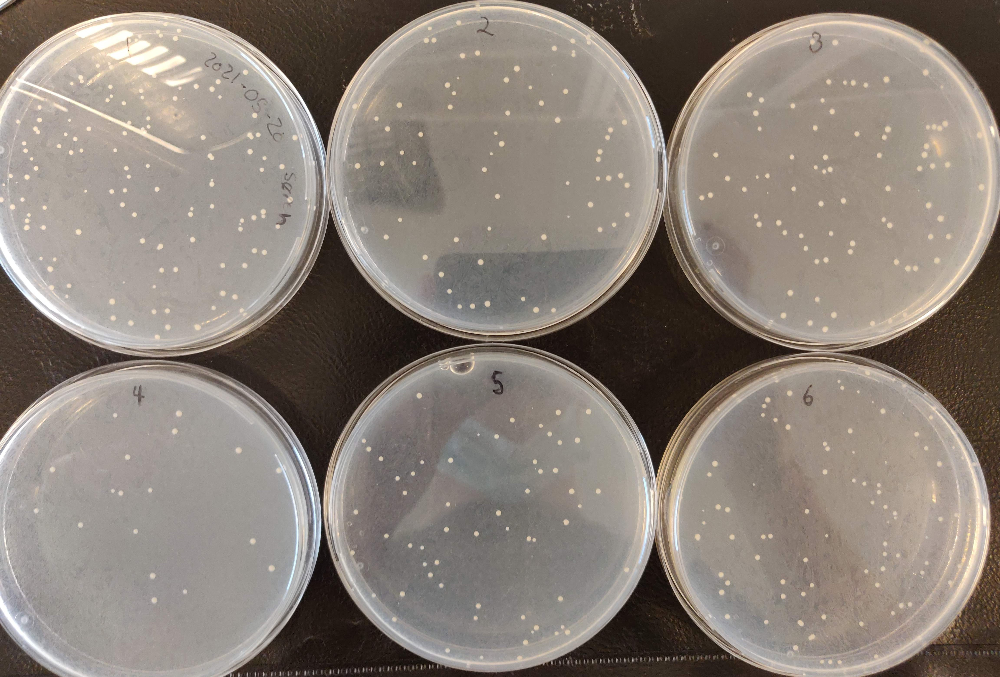

In [117]:
IPython.core.display.Image(bioimager_path + '2021-05-25_1-6.jpg', width=600)

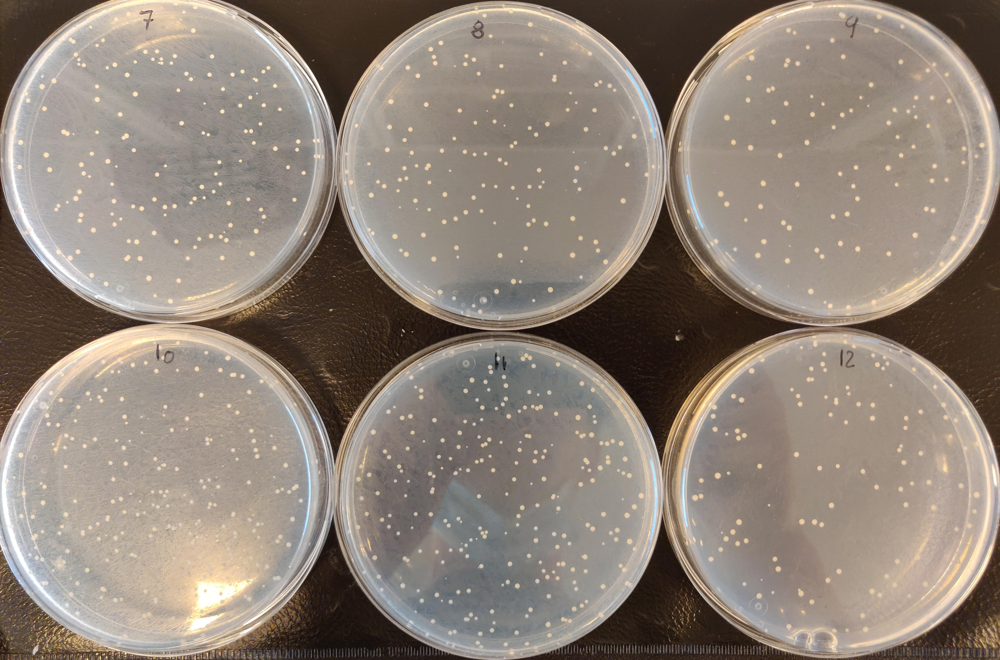

In [118]:
IPython.core.display.Image(bioimager_path + '2021-05-25_7-12.jpg', width=600)

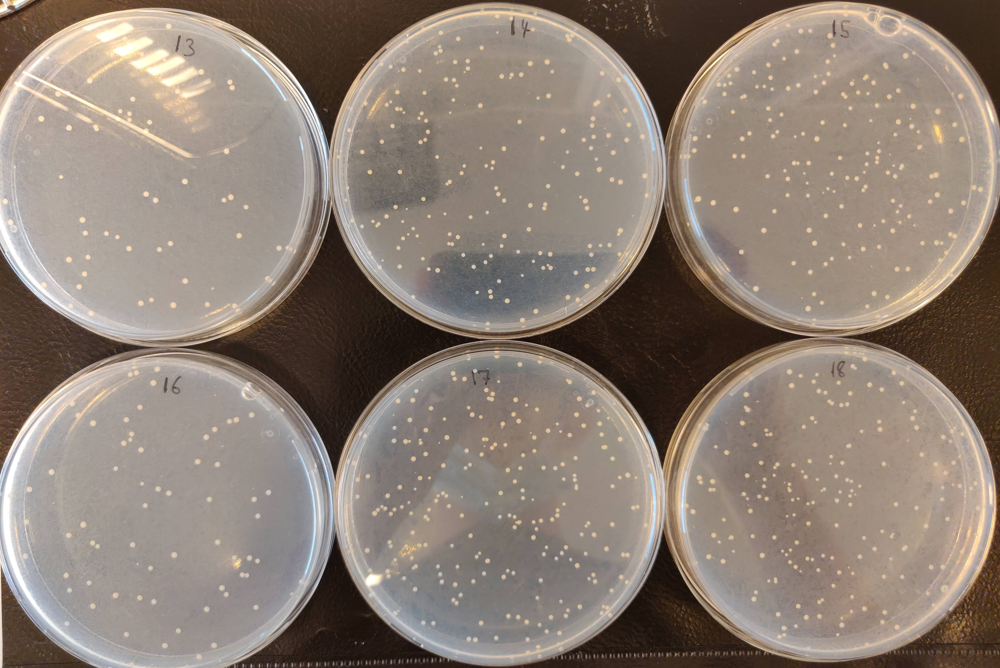

In [119]:
IPython.core.display.Image(bioimager_path + '2021-05-25_13-18.jpg', width=600)

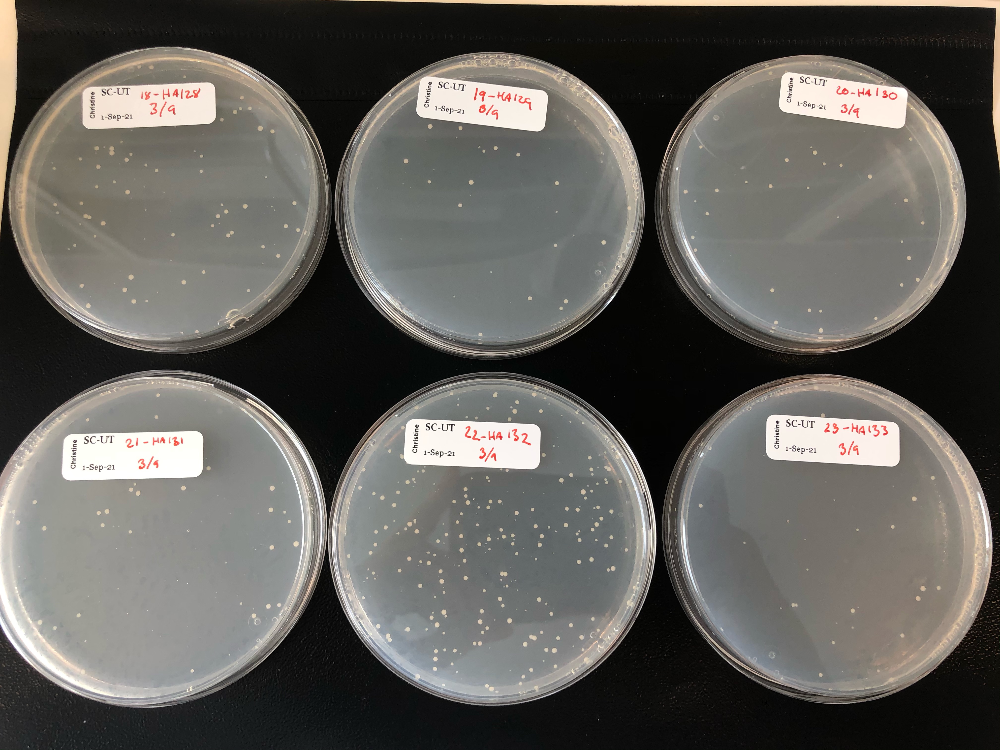

In [120]:
IPython.core.display.Image(bioimager_path + '2021-05-25_18-24.jpeg', width=600)

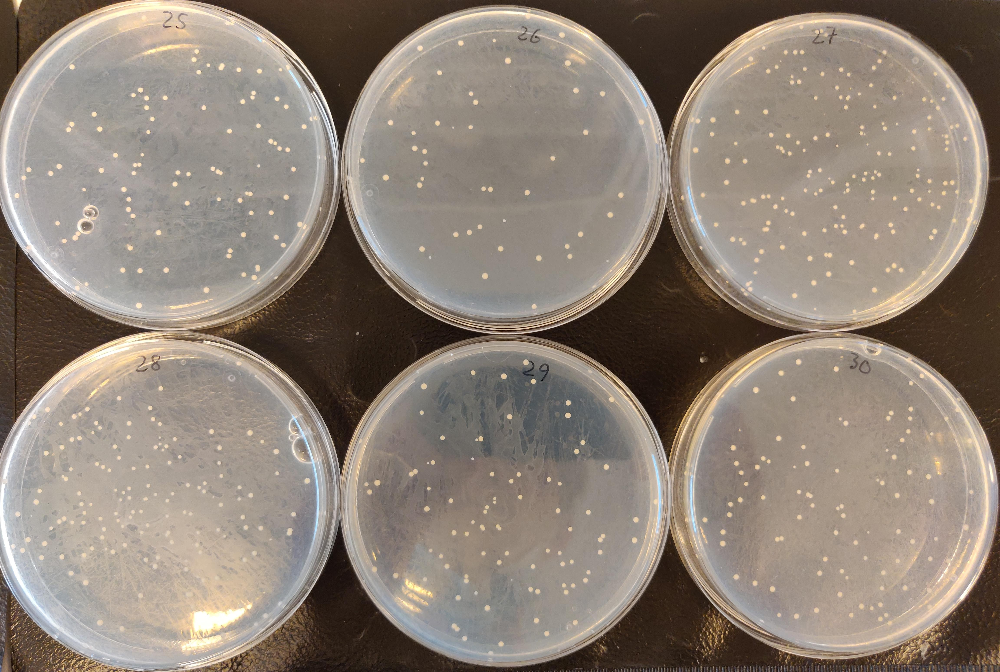

In [121]:
IPython.core.display.Image(bioimager_path + '2021-05-25_25-30.jpg', width=600)

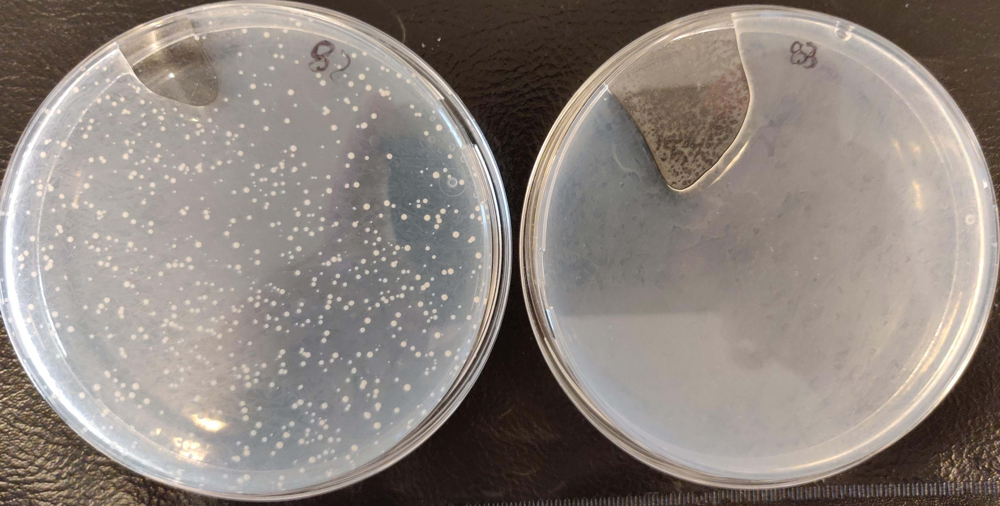

In [122]:
# 82 is the positive and 83 is the negative control here
IPython.core.display.Image(bioimager_path + '2021-05-25_82-83.jpg', width=600)

### 4.2 Second Transformation - 31-60 + controls

In [123]:
#Perform 31-40, 44-60
transf_idx = list(range(31,41)) + list(range(44,61)) + [82, 80]

# names
reaction_names_3 = [reaction_names[i] for i in transf_idx]

# reaction participants
reaction_participants_3 = [reaction_participants[i] for i in transf_idx]

# wanted amounts
new_dict_with_wanted_amounts2 = transformation_partitipants(reaction_participants_3,sgRNA_plasmid_name='pESC-URA-gRNA_XI2-2',sgRNA_plasmid_conc= 0.00014  )

# Which media needs to be used
media_3 = [media[i] for i in transf_idx]

# 
transf_names = transformation_mix(reaction_names_3, reaction_participants_3, wanted_amounts = new_dict_with_wanted_amounts2, water_dna_p_reac = 74, media = media_3)
transf_names.index += 1
transf_names = transf_names.set_index([pd.Index([str(ID) for ID in transf_idx])])
transf_names

,name,XI-2_UP,CacuG8H_tADH1,pool_promoter_sites,AanCPR_tCYC1,seq_3HMRtcpy,XI-2_DW,pESC-URA-gRNA_XI2-2,AraCPR_tCYC1,CloCPR_tCYC1,RseCPR_tCYC1,AhuCPR_tCYC1,AniCPR_tCYC1,CacCPR_tCYC1,OeuCPR_tCYC1,CpoCPR_tCYC1,OpumG8H_tADH1,CroCPR_tCYC1,CroG8H_tADH1,OeuG8H_tADH1,pL_01_C2_(pRS414-TRP),water,plate on
31,HA52,3.7,11.9,6.7,14.9,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,SC-UT
32,HA53,3.7,11.9,6.7,NaN,9.2,3.7,6.9,14.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.2,SC-UT
33,HA54,3.7,11.9,6.7,NaN,9.2,3.7,6.9,NaN,15.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.8,SC-UT
34,HA55,3.7,11.9,6.7,NaN,9.2,3.7,6.9,NaN,NaN,15.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.8,SC-UT
35,HA56,3.7,11.9,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,15.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.8,SC-UT
36,HA57,3.7,11.9,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,14.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.2,SC-UT
37,HA58,3.7,11.9,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,15.0,NaN,NaN,NaN,NaN,NaN,NaN,NaN,16.9,SC-UT
38,HA59,3.7,11.9,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,15.0,NaN,NaN,NaN,NaN,NaN,NaN,16.9,SC-UT
39,HA60,3.7,11.9,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14.4,NaN,NaN,NaN,NaN,NaN,17.5,SC-UT
40,HA61,3.7,NaN,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,12.1,15.1,NaN,NaN,NaN,16.6,SC-UT


In [124]:
reaction_participants_3_flat_no_duplicates = recs_no_duplicates([item for sublist in reaction_participants_3 for item in sublist])
lst = transf_names.columns.tolist()
lst = [x for x in lst if x not in ('name', 'water', 'plate on')]
assert len(reaction_participants_3_flat_no_duplicates) == len(lst)
reaction_participants_3_flat_no_duplicates

[Dseqrecord(-569),
 Dseqrecord(-1827),
 Dseqrecord(-1033),
 Dseqrecord(-2298),
 Dseqrecord(-1415),
 Dseqrecord(-563),
 Dseqrecord(-7797),
 Dseqrecord(-2262),
 Dseqrecord(-2328),
 Dseqrecord(-2328),
 Dseqrecord(-2328),
 Dseqrecord(-2268),
 Dseqrecord(-2310),
 Dseqrecord(-2310),
 Dseqrecord(-2223),
 Dseqrecord(-1860),
 Dseqrecord(-2328),
 Dseqrecord(-1695),
 Dseqrecord(-1803),
 Dseqrecord(-4788)]

In [125]:
for amp in reaction_participants_3_flat_no_duplicates:
    print(amp.name, amp.annotations['batches'][0]['location'], amp.annotations['batches'][0]['concentration'])

XI-2_UP ds_dna_box_rack_0_A1 50.0
CacuG8H_tADH1 ds_dna_box_rack_0_B9 50.0
pool_promoter_sites ds_dna_temp 50.0
AanCPR_tCYC1 ds_dna_box_rack_0_A5 50.0
seq_3HMRtcpy ds_dna_box_rack_0_A3 50.0
XI-2_DW ds_dna_box_rack_0_A2 50.0
pESC-URA-gRNA_XI2-2 plasmid_plates_0_A5 103.0
AraCPR_tCYC1 ds_dna_box_rack_0_B3 50.0
CloCPR_tCYC1 ds_dna_box_rack_0_A6 50.0
RseCPR_tCYC1 ds_dna_box_rack_0_B2 50.0
AhuCPR_tCYC1 ds_dna_box_rack_0_A4 50.0
AniCPR_tCYC1 ds_dna_box_rack_0_A8 50.0
CacCPR_tCYC1 ds_dna_box_rack_0_A7 50.0
OeuCPR_tCYC1 ds_dna_box_rack_0_B1 50.0
CpoCPR_tCYC1 ds_dna_box_rack_0_A9 50.0
OpumG8H_tADH1 ds_dna_box_rack_0_B8 50.0
CroCPR_tCYC1 ds_dna_box_rack_0_B4 50.0
CroG8H_tADH1 ds_dna_box_rack_0_B7 50.0
OeuG8H_tADH1 ds_dna_box_rack_0_C4 50.0
pL_01_C2_(pRS414-TRP) plasmid_plates_0_A10 123.0


#### Calcualte how much of each part is needed and the different components of the transformation mixture.

In [126]:
transf_names.sum(numeric_only = True)

XI-2_UP                   99.9
CacuG8H_tADH1            107.1
pool_promoter_sites      180.9
AanCPR_tCYC1              29.8
seq_3HMRtcpy             248.4
XI-2_DW                   99.9
pESC-URA-gRNA_XI2-2      193.2
AraCPR_tCYC1              29.4
CloCPR_tCYC1              30.2
RseCPR_tCYC1              45.3
AhuCPR_tCYC1              45.3
AniCPR_tCYC1              44.1
CacCPR_tCYC1              45.0
OeuCPR_tCYC1              45.0
CpoCPR_tCYC1              43.2
OpumG8H_tADH1             84.7
CroCPR_tCYC1              45.3
CroG8H_tADH1             110.0
OeuG8H_tADH1              11.7
pL_01_C2_(pRS414-TRP)     12.7
water                    594.9
dtype: float64

In [127]:
calculate_volumes(vol_p_reac = 360, 
        no_of_reactions = 31,
        standard_reagents = ["PEG", "LiAc_1M", "ssDNA", "water_dna"],
        standard_volumes = [240, 36, 10, 74])

,vol_p_reac,vol_p_31_reac
PEG,240.0,7440.0
LiAc_1M,36.0,1116.0
ssDNA,10.0,310.0
water_dna,74.0,2294.0
Total,360.0,11160.0


#### Results for strain 31-60 

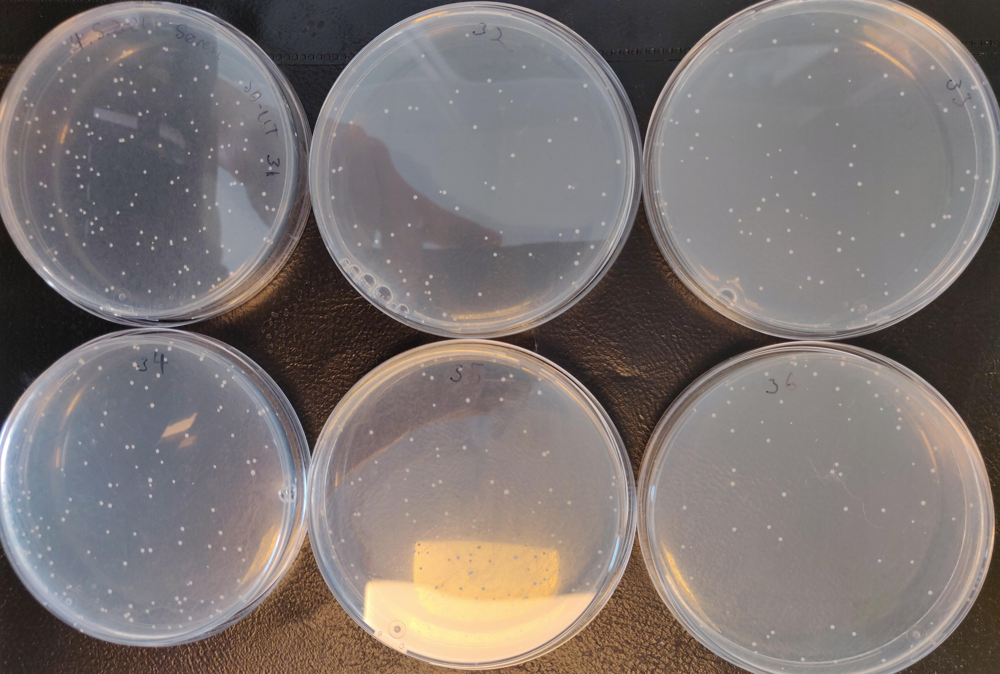

In [128]:
IPython.core.display.Image(bioimager_path + '2021-05-07_31-36.jpg', width=600)

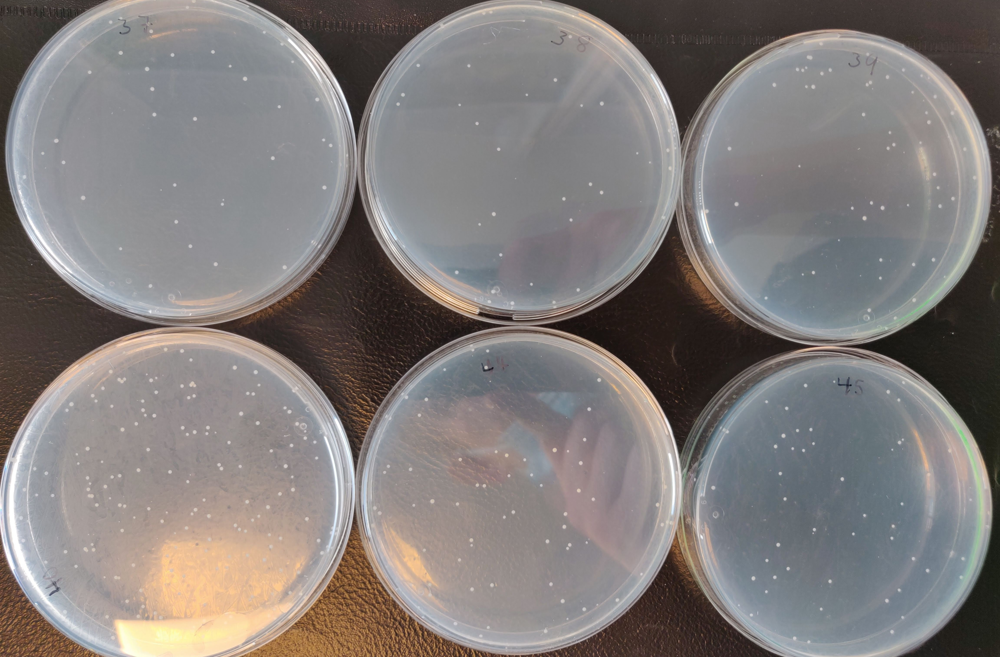

In [129]:
IPython.core.display.Image(bioimager_path + '2021-05-07_37-40_44-45.jpg', width=600)

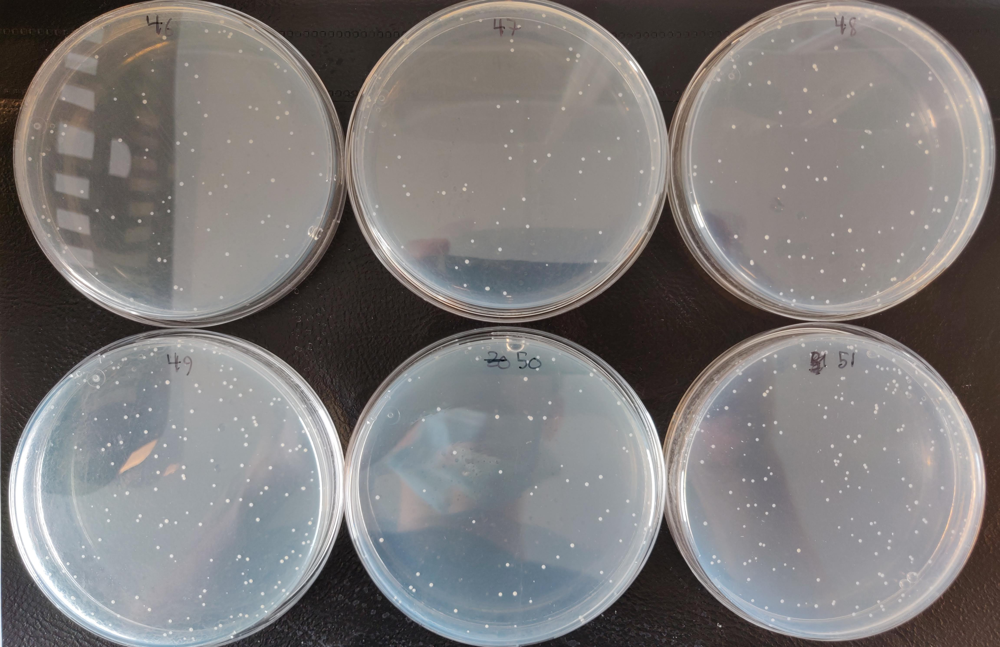

In [130]:
IPython.core.display.Image(bioimager_path +'2021-05-07_46-51.jpg', width=600)

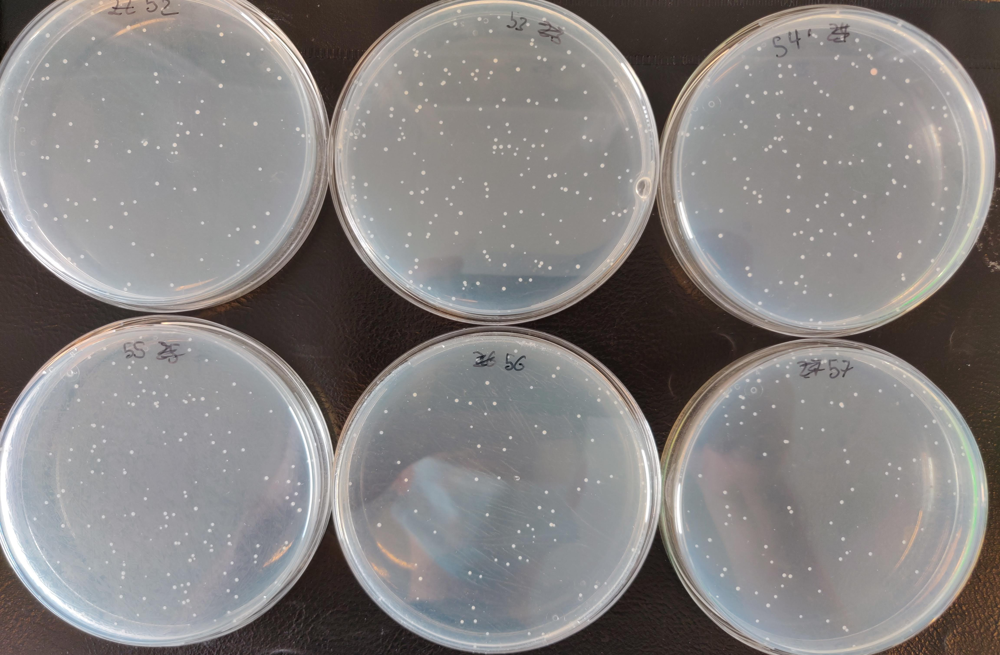

In [131]:
IPython.core.display.Image(bioimager_path + '2021-05-07_52-57.jpg', width=600)

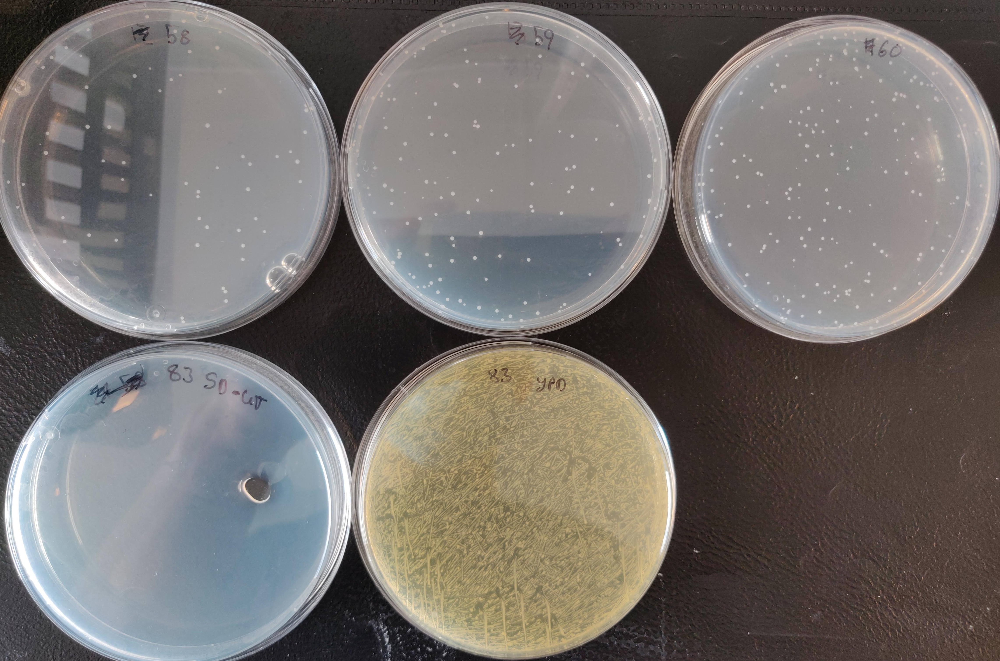

In [132]:
IPython.core.display.Image(bioimager_path + '2021-05-07_58-60_83_83.jpg', width=600)

### 4.3 Third transformation - 61-80 + controls

In [133]:
#Perform 61, 81
transf_idx = list(range(60,81)) + [81,82]

# Get the names
reaction_names_4 = [reaction_names[i] for i in transf_idx]

# The reaction partitipants
reaction_participants_4 = [reaction_participants[i] for i in transf_idx]

# names_matrix 
names_matrix = [[] for i in range(len(reaction_participants_4))]

# dict with the wanted amouts for each part
new_dict_with_wanted_amounts4 = transformation_partitipants(reaction_participants_4,sgRNA_plasmid_name='pESC-URA-gRNA_XI2-2',sgRNA_plasmid_conc= 0.00014  )

# Add the media
media_4 = [media[i] for i in transf_idx]

In [134]:
transf_names = transformation_mix(reaction_names_4, reaction_participants_4, wanted_amounts = new_dict_with_wanted_amounts4, water_dna_p_reac = 74, media = media_4)
transf_names = transf_names.set_index([pd.Index([str(ID + 1) for ID in transf_idx])])
transf_names

,name,XI-2_UP,OeuG8H_tADH1,pool_promoter_sites,CroCPR_tCYC1,seq_3HMRtcpy,XI-2_DW,pESC-URA-gRNA_XI2-2,AanCPR_tCYC1,AraCPR_tCYC1,CloCPR_tCYC1,RseCPR_tCYC1,AhuCPR_tCYC1,AniCPR_tCYC1,CacCPR_tCYC1,OeuCPR_tCYC1,CpoCPR_tCYC1,CcalG8H_tADH1,pL_01_C2_(pRS414-TRP),pL_01_C4_(pRS416-URA),water,plate on
61,HA81,3.7,11.7,6.7,15.1,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,SC-UT
62,HA82,3.7,11.7,6.7,NaN,9.2,3.7,6.9,14.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.2,SC-UT
63,HA83,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,14.7,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.4,SC-UT
64,HA84,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,15.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,SC-UT
65,HA85,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,15.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,SC-UT
66,HA86,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,15.1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,17.0,SC-UT
67,HA87,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,14.7,NaN,NaN,NaN,NaN,NaN,NaN,17.4,SC-UT
68,HA88,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,15.0,NaN,NaN,NaN,NaN,NaN,17.1,SC-UT
69,HA89,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,15.0,NaN,NaN,NaN,NaN,17.1,SC-UT
70,HA90,3.7,11.7,6.7,NaN,9.2,3.7,6.9,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,14.4,NaN,NaN,NaN,17.7,SC-UT


#### Calcualte how much of each part is needed and the different components of the transformation mixture.

In [135]:
transf_names.sum(numeric_only = True)

XI-2_UP                   74.0
OeuG8H_tADH1             117.0
pool_promoter_sites      134.0
CroCPR_tCYC1              30.2
seq_3HMRtcpy             184.0
XI-2_DW                   74.0
pESC-URA-gRNA_XI2-2      144.9
AanCPR_tCYC1              29.8
AraCPR_tCYC1              29.4
CloCPR_tCYC1              30.2
RseCPR_tCYC1              30.2
AhuCPR_tCYC1              30.2
AniCPR_tCYC1              29.4
CacCPR_tCYC1              30.0
OeuCPR_tCYC1              30.0
CpoCPR_tCYC1              28.8
CcalG8H_tADH1            117.0
pL_01_C2_(pRS414-TRP)     25.4
pL_01_C4_(pRS416-URA)     18.7
water                    514.8
dtype: float64

In [136]:
calculate_volumes(vol_p_reac = 360, 
        no_of_reactions = 27,
        standard_reagents = ["PEG", "LiAc_1M", "ssDNA", "water_dna"],
        standard_volumes = [240, 36, 10, 74])

,vol_p_reac,vol_p_27_reac
PEG,240.0,6480.0
LiAc_1M,36.0,972.0
ssDNA,10.0,270.0
water_dna,74.0,1998.0
Total,360.0,9720.0


#### Results for strain 61-80

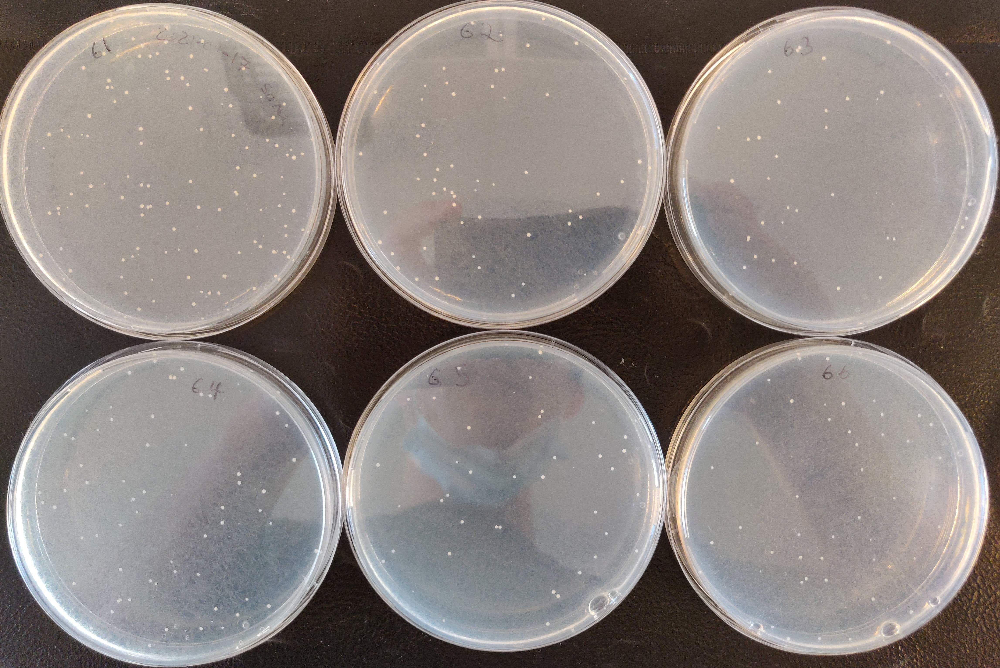

In [137]:
IPython.core.display.Image(bioimager_path + '2021-05-21_61-66.jpg', width=600)

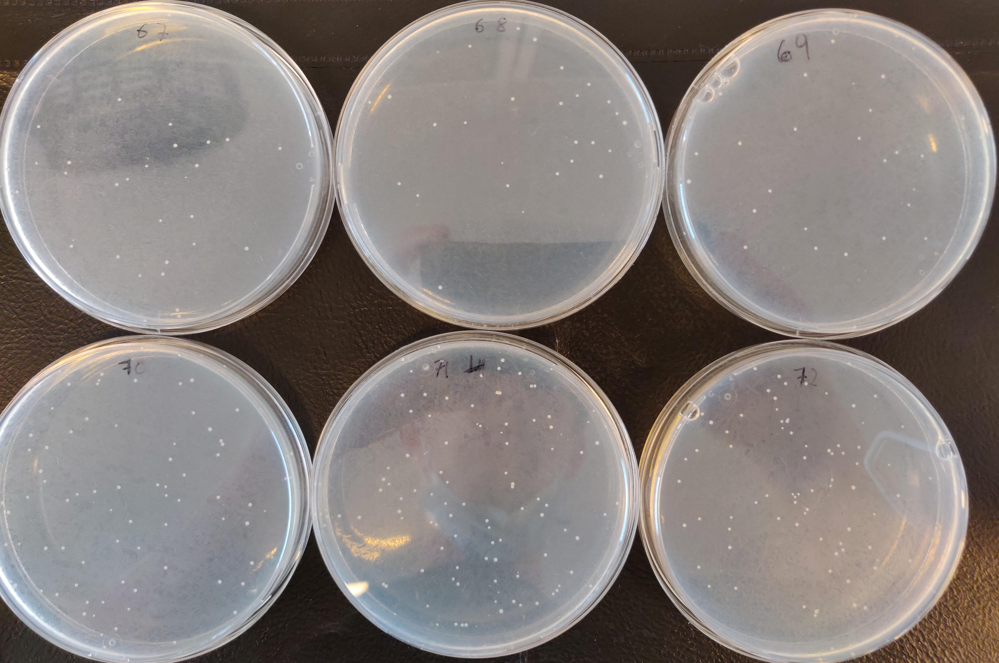

In [138]:
IPython.core.display.Image(bioimager_path + '2021-05-21_67-72.jpg', width=600)

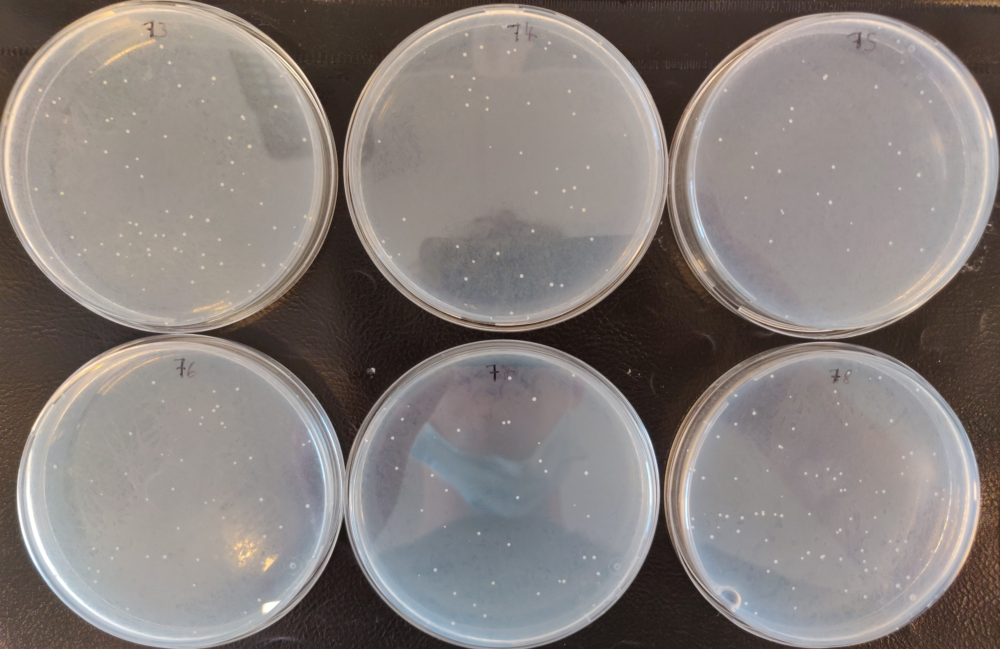

In [139]:
IPython.core.display.Image(bioimager_path + '2021-05-21_73-78.jpg', width=600)

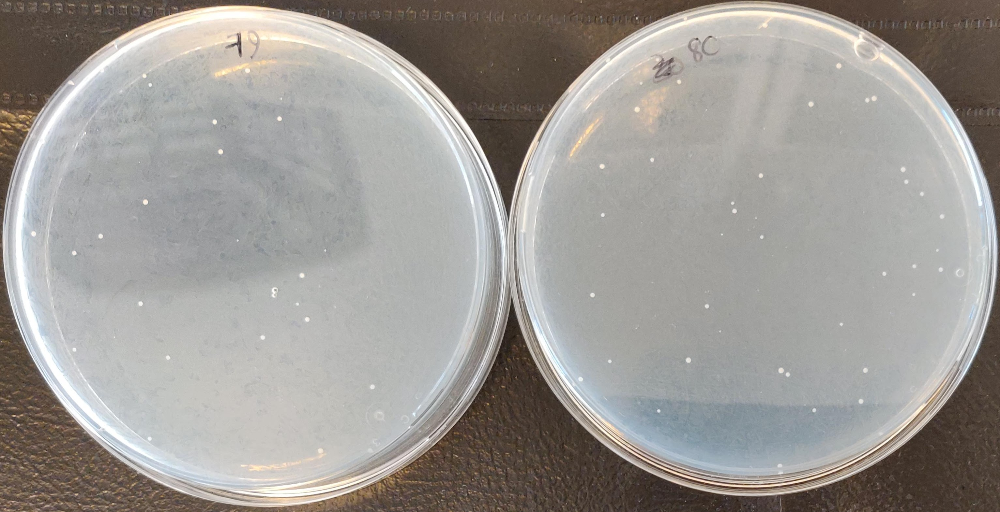

In [140]:
IPython.core.display.Image(bioimager_path + '2021-05-21_79-80.jpg', width=600)

## 5. Preparing Analytics

When making libraries sample maximally same no as potential constructs e.g. 1280 in our case
Save that many colonies in glycerol e.g 1440colonies/ 96WellsPerPlate = 15 plates , with blanks and bg strain in each maybe 16  96-well plates.
When checking library, sampling pick random colonies from random plates (take from all) and run.
E.g. 3x {90 colonies [3 colonies * 30 plates] + 4x MIA-CH-A2, 1xMIA-CM-3 and 1xblank = 96 wells)}

**MIA-HA-51-80_analytics_experiment**

Strains  
1. YP49
    - MIA-HA-51 - 80 (30 plates i.e. transf. nos 31-60)
    - (3 colonies * 30 plates) + 4x MIA-CH-A2, 1xMIA-CM-3 and 1xblank = 96 wells

Media feed: 0.2 mM geraniol & 1 mM tryptamine
1. YP + 2 % glucose + feed

Sampling times:
1. One: Day: 6

For each sampling time: 
1. Cultivation 30C, 300 rpm:
2. (Monday 10/5): Inoculate precultures. Transfer 10 of YP48 g.stock to 90 media (-feed).
3. (Wednesday 12, at 11): Inoculate maincultures. Transfer 10 of preculture to 500 media
4. (Tuesday 18, at 11): 
    Sample
     1. Transfer 10 of mainculture into 140 to measure OD (in incubator while measuring) # Skipped due to dense cultures
     2. Transfer 200 into new 96 well plate,
     3. Add 20 uL 10 mg/L caffeine stock
     4. Transfer 220 onto filter in collection plate, centrifuge (2000 g x 1 min; put collection plate in -80C) 
     5. Measure MIAs (extracellular loganin)
    Prepare standards (in its own 96wellplate)
        1. Prepare [standards](/files/reports/spreadsheets/20200728_MIA_standards_prep_scheme_v2_std_v13.xlsx)
        2. Transfer X ul Std_MM_v13 onto filter in collection plate, centrifuge (2000 g x 1 min; put collection plate in -80C)      
5. (TBD): Khem run plate
6. (TBD): Data analysis

YPD + feed
1. stocks (in absolute ethanol)
    - 100 mM geraniol (Molar mass 154.253 g·mol−1, Density 0.889 g·cm-3)
        - 154.253 mg (or 173.5 µl) in 10 mL
            $$ \frac{\frac{x mg}{154.253 mg/mmol}}{10 ml} = 0.100 mmol/ml $$
            $$0.100 mmol/ml * 10 ml * 154.253 mg/ml = 154.253 mg$$
            $$ \frac{154.253 mg}{889mg/cm} * 1000 ul/ml = 173.5 ul $$  
    - 1000 mM tryptamine (Molar mass 160.220 g·mol−1) 
        - 160.220 mg in 1 mL
            $$ 1 mmol/ml * 1 ml * 160.220 mg/mmol = 160.220 mg$$

2. Add x to 100 ml YPD
    - geraniol: 200 µl 100 mM to make 0.2 mM (500x dilution)
       $$ \frac{100000 ul}{500} = 200 ul $$
    - tryptamine: 100 µl 1000 mM to make 1 mM (1000x dilution)
       $$ \frac{100000 ul}{1000} = 100 ul $$

In [141]:
path = 'ConStrain_on_google_colab/data/07-lcms/raw/plate_design/'

yp49 = pd.read_excel(path + 'lc0001.xlsx').reset_index(drop=True)
yp50 = pd.read_excel(path + 'lc0002.xlsx').reset_index(drop=True)
yp51 = pd.read_excel(path + 'lc0003.xlsx').reset_index(drop=True)
yp49.head()

,position,Sample name,Cellular compartment,Medium,Sample Type,Temperature (C),Timepoint (h),Cultivation Container ID/Position,Operator Name,Replicate #,Strain,genotype
0,A01,MIA-HA-51_1,Extracellular Region,YPD + 1 mM tryptamine + 0.2 mM geraniol,Specimen,30,144,NaN,Soeren Petersen,1,MIA-HA-51,CacuG8H CroCPR
1,A02,MIA-HA-51_2,Extracellular Region,YPD + 1 mM tryptamine + 0.2 mM geraniol,Specimen,30,144,NaN,Soeren Petersen,2,MIA-HA-51,CacuG8H CroCPR
2,A03,MIA-HA-51_3,Extracellular Region,YPD + 1 mM tryptamine + 0.2 mM geraniol,Specimen,30,144,NaN,Soeren Petersen,3,MIA-HA-51,CacuG8H CroCPR
3,A04,MIA-HA-52_1,Extracellular Region,YPD + 1 mM tryptamine + 0.2 mM geraniol,Specimen,30,144,NaN,Soeren Petersen,1,MIA-HA-52,CacuG8H AanCPR
4,A05,MIA-HA-52_2,Extracellular Region,YPD + 1 mM tryptamine + 0.2 mM geraniol,Specimen,30,144,NaN,Soeren Petersen,2,MIA-HA-52,CacuG8H AanCPR


In [142]:
yp49['prow'] = yp49['position'].str.slice(stop=-2)
yp49['pcol'] = yp49['position'].str.slice(start=-2)
plate_plot(yp49, 'Strain')

Strain                                                         \
pcol         01         02         03         04         05         06   
prow                                                                     
A     MIA-HA-51  MIA-HA-51  MIA-HA-51  MIA-HA-52  MIA-HA-52  MIA-HA-52   
B     MIA-HA-55  MIA-HA-55  MIA-HA-55  MIA-HA-56  MIA-HA-56  MIA-HA-56   
C     MIA-HA-59  MIA-HA-59  MIA-HA-59  MIA-HA-60  MIA-HA-60  MIA-HA-60   
D     MIA-HA-63  MIA-HA-63  MIA-HA-63  MIA-HA-64  MIA-HA-64  MIA-HA-64   
E     MIA-HA-67  MIA-HA-67  MIA-HA-67  MIA-HA-68  MIA-HA-68  MIA-HA-68   
F     MIA-HA-71  MIA-HA-71  MIA-HA-71  MIA-HA-72  MIA-HA-72  MIA-HA-72   
G     MIA-HA-75  MIA-HA-75  MIA-HA-75  MIA-HA-76  MIA-HA-76  MIA-HA-76   
H     MIA-HA-79  MIA-HA-79  MIA-HA-79  MIA-HA-80  MIA-HA-80  MIA-HA-80   

                                                                        
pcol         07         08         09         10         11         12  
prow                                                                    
A     MIA-HA-53  MIA-HA-53  MIA-HA-53  MIA-HA-54  MIA-HA-54  MIA-HA-54  
B     MIA-HA-57  MIA-HA-57  MIA-HA-57  MIA-HA-58  MIA-HA-58  MIA-HA-58  
C     MIA-HA-61  MIA-HA-61  MIA-HA-61  MIA-HA-62  MIA-HA-62  MIA-HA-62  
D     MIA-HA-65  MIA-HA-65  MIA-HA-65  MIA-HA-66  MIA-HA-66  MIA-HA-66  
E     MIA-HA-69  MIA-HA-69  MIA-HA-69  MIA-HA-70  MIA-HA-70  MIA-HA-70  
F     MIA-HA-73  MIA-HA-73  MIA-HA-73  MIA-HA-74  MIA-HA-74  MIA-HA-74  
G     MIA-HA-77  MIA-HA-77  MIA-HA-77  MIA-HA-78  MIA-HA-78  MIA-HA-78  
H     MIA-CH-A2  MIA-CH-A2  MIA-CH-A2  MIA-CH-A2   MIA-CM-3        NaN

## 6. Genotyping 

- 240 (80*3) library colonies are positioned in 3*96 well plates. See "../data/processed/023_LC-MS/yp48-51_meta.csv"
- DNA has been extracted in same format 
- Edge wells cannot be used for PCR's as plates cannot close properly and evaporation hinders reaction.
- Thus DNA must be rearranged before PCR's. Two plates per 96 well. That is 6 (=2*3) 96 well plates
- PCRs must be run for each amplification site (G8H and CPR)
- Thus 12 (=2x6) 96 well plates PCR plates must be run in total. 
- After PCR's are run reaarange plates back into 6(=2*3) 96 well plates
- Labchip
- If labchip ok: Eurofins plate seq with sequencing primers: pad_pG8H_fw, pad_pCPR_fw
- Eurofins returns 2xsequence files for of the 240 library colony 
- Use Sørens program to find match of promoter with list of 8 possible promoters 
- When promoters have been determined we have the input data for ML and recommendations with ART
    - Should points us towards promoters and homologs not to use and thus a new library meaning the the circle can continue.
- These 

1. Design and order primers
2. Simulate
3. Genotype
    - HT yeast dna extraction protocol for PCR of YP49-51 Protocol: IPython.display.FileLink('../references/methods.ipynb')
    - Colony PCR
6. Glycerol stock

### 6.1 Primers for genotyping


Primers
1. Design
2. Upload (name, sequence, register)
3. Order and receive
    - when arrived
        - retrive primer (physically)
        - find box with available position (algorithmically)
        - create container and batch (for both 10 and 100 µM stock) (algorithmically)
        - dilute, label and place (physically)
4. Download for simulation

#3. Order and receive (Add code)
- Create .csv for upload
- selenium open idt.com order page

In [143]:
from pydna.dseqrecord import Dseqrecord

In [144]:
path = 'ConStrain_on_google_colab/data/06-lims/csv_database/'
pad_pG8H_fw2 =get_dna_from_box_name('pad_pG8H_fw2','primer_box', database_path = path)#
tADH1_160_rv = get_dna_from_box_name('tADH1_160_rv','primer_box', database_path = path)#


pad_pCPR_fw2 =get_dna_from_box_name('pad_pCPR_fw2','primer_box', database_path = path)#
tCYC1_150_rv = get_dna_from_box_name('tCYC1_150_rv','primer_box', database_path = path)#

### 6.2 Simulate


Background strain. As we do not know the actual genotype (promoter combination) of the individual library colonies we are using a similar genotype to simulate PCR length.

As the two primer pairs each should yield the amplicon of a given length just two pcr's are simulated out of 2x240 amplifications

We are also sequencing MIA-CM-3 and MIA-CH-A2 as controls

no_of_colonies = 240



In [145]:
HA2 = SeqIO.read("ConStrain_on_google_colab/data/03-strain_sequences/background_and_controls/HA2.fasta", 'fasta')
HA2.annotations['topology']='linear'
HA2

SeqRecord(seq=Seq('GTTTGTAGTTGGCGGTGGAGCCAGCAGTGGCTACAATAACCAATATCAGTGTGG...CTC'), id='seq_sJ1saBKK', name='seq_sJ1saBKK', description='seq_sJ1saBKK <unknown description>', dbxrefs=[])

In [146]:
G8H_amplicon = pydna.amplify.pcr(tADH1_160_rv, pad_pG8H_fw2, HA2)
CPR_amplicon = pydna.amplify.pcr(pad_pCPR_fw2, tCYC1_150_rv, HA2)

# G8H
G8H_amplicon.name = "HA21-100 G8H"
G8H_amplicon.annotations['batches'] = [{'location':"yp49-51"}]
G8H_amplicon.annotations['template_location'] = 'yp49-51'

# CPR
CPR_amplicon.name = "HA21-100 CPR"
CPR_amplicon.annotations['batches'] = [{'location':"yp49-51"}]
CPR_amplicon.annotations['template_location'] = 'yp49-51'

In [147]:
pcr_locations([G8H_amplicon,CPR_amplicon])

,location,name,template,fw,rv
0,yp49-51,HA21-100 G8H,yp49-51,primer_box_rack_2_A6,primer_box_rack_2_C2
1,yp49-51,HA21-100 CPR,yp49-51,primer_box_rack_2_C3,primer_box_rack_2_A9


For each amplification site (G8H and CPR)
- Make 240 (80 plates * 3 colonies per plate) * 10 % extra to account for pipetting error 

In [148]:
# for each amplification site (G8H and CPR)
# make 240 (80 plates * 3 colonies per plate) * 10 % extra to account for pipetting error 
n = 70
no_of_react = n + n/10
no_of_react

77.0

In [149]:
calculate_volumes(vol_p_reac = 30, 
        no_of_reactions = no_of_react,
        standard_reagents = ["Template", "Primer 1", "Primer 2", "H20", "Pol"],
        standard_volumes = [1, 2.5, 2.5, 19, 25])

,vol_p_reac,vol_p_77.0_reac
Template,0.6,46.2
Primer 1,1.5,115.5
Primer 2,1.5,115.5
H20,11.4,877.8
Pol,15.0,1155.0
Total,30.0,2310.0


Make two pcr mixes - one for G8H and one for CPR. 

In [150]:
from constrain.lab.PCR import Q5_NEB_PCR_program_program

Now we can visualize the pcr programs in the following way: 

In [151]:
# Choose which polymerase you're working with
G8H_amplicon.annotations['polymerase'] = "OneTaq Hot Start"
# calculate the process speed
calculate_processing_speed(G8H_amplicon)

Amplicon(2571)

In [152]:
Q5_NEB_PCR_program_program(G8H_amplicon)

|98°C|98°C               |    |tmf:59.0
|____|_____          72°C|72°C|tmr:64.0
|30 s|10s  \ 60.0°C _____|____|60s/kb
|    |      \______/ 2:35|2min|GC 39.2%
|    |       20s         |    |2571bp


In [153]:
CPR_amplicon.annotations['polymerase'] = "OneTaq Hot Start"
calculate_processing_speed(CPR_amplicon)

Amplicon(3228)

In [154]:
Q5_NEB_PCR_program_program(CPR_amplicon)

|98°C|98°C               |    |tmf:64.0
|____|_____          72°C|72°C|tmr:62.0
|30 s|10s  \ 63.0°C _____|____|60s/kb
|    |      \______/ 3:14|2min|GC 41.9%
|    |       20s         |    |3228bp


PCR:
run two different PCR's 
- polymerase: OneTq 60 sek/kb
- Program: 
- Annealing temp:
    - 51/54 - 60/63 WITH NEB
- Elongation time: 
    - 2:34/3:13

HA21-100 G8H
HA21-100 CPR


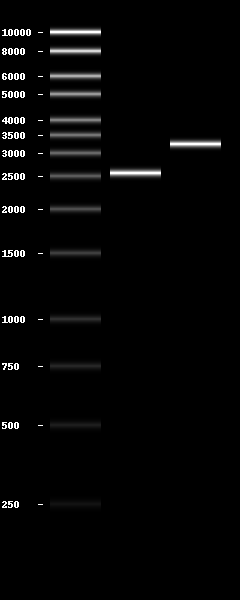

In [155]:
bands = [G8H_amplicon, CPR_amplicon]
for band in bands:
    print(band.name)
pydna.gel.gel([pydna.ladders.GeneRuler_1kb,*[[band] for band in bands]])

### 6.3 Colony pcr result

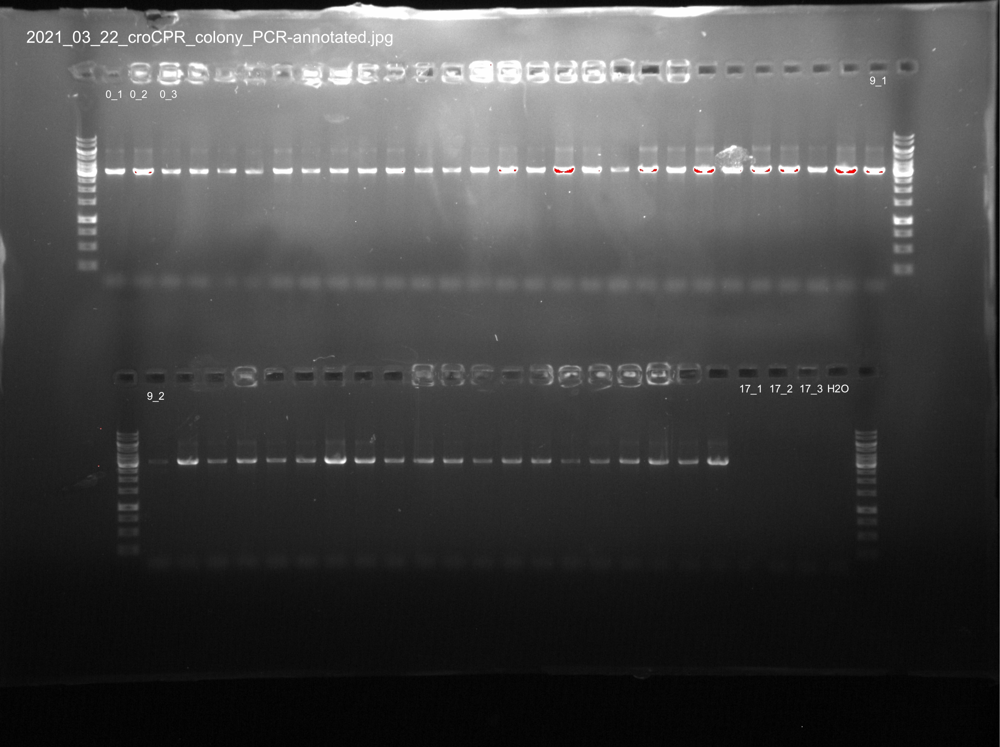

In [156]:
IPython.core.display.Image(bioimager_path +'2021-03-22_croCPR_colony_PCR.jpg', width=800)

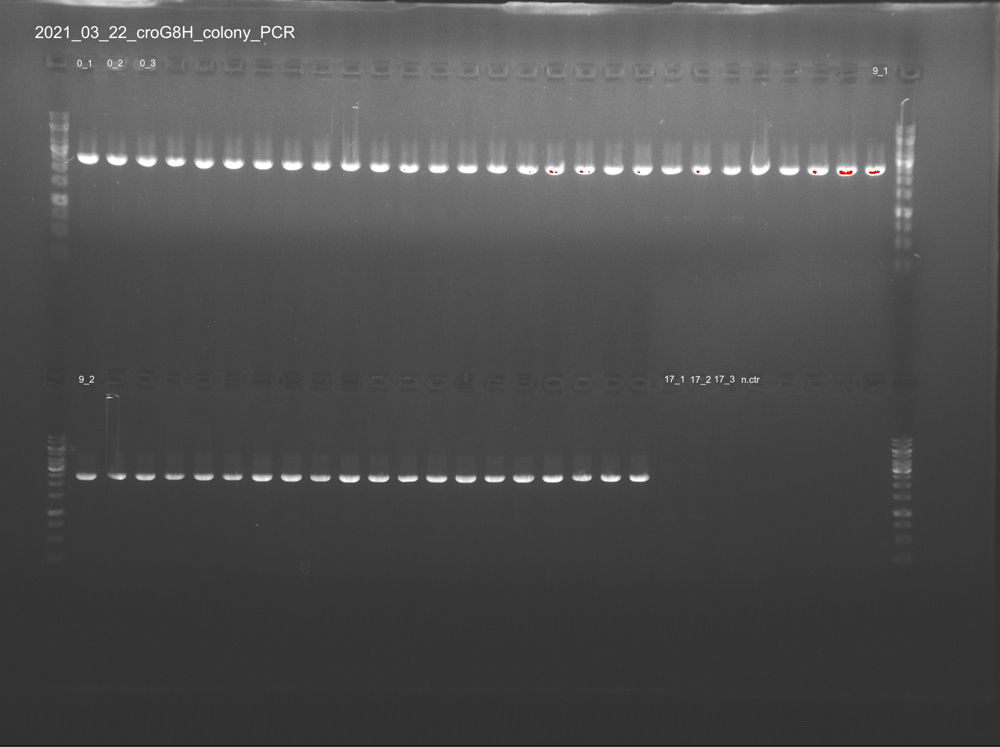

In [157]:
IPython.core.display.Image(bioimager_path +'2021-03-22_croG8H_colony_PCR.jpg', width=800)